# Tutorial

The following pages show an example analysis with emgfit broken down into the essential steps. Many of the more advanced features of emgfit are left out or only briefly mentioned in passing, so feel free to explore the documentation further!  

This tutorial was created in the Jupyter Notebook `emgfit_tutorial.ipynb` which can be found in the `emgfit/emgfit/examples/tutorial/` directory of the emgfit distribution. Feel free to copy the tutorial folder to a different directory (outside of the `emgfit/` directory!) and follow along with the tutorial by actually running the code. You can also use this notebook as a template for your own analyses (consider removing some of the explanations). It is recommended to use a separate notebook for each spectrum to be fitted. This enables you to go back to the notebook at any time and check on all the details of how the fits were performed. 

emgfit is optimized to be run within Jupyter Notebooks. There is dozens of decent introductions to using Jupyter Notebooks, a nice overview can e.g. be found at https://realpython.com/jupyter-notebook-introduction/. Naturally, the first step of an analysis with emgfit is starting up your notebook server by running ``jupyter notebook`` in your command-line interface. This should automatically make the Jupyter interface pop up in a browser window. From there you can navigate to different directories and create a new notebook (`new` panel on the top right) or open an existing notebook (.ipynb files). If you installed emgfit into a virtual environment be sure to activate it before starting the notebook server and check in the notebook that the correct kernel is selected.

## Import the package
Assuming you have setup emgfit following the [installation instructions](installation.rst), the first step after launching your Jupyter Notebook will be importing the emgfit package:

In [1]:
### Import fit package 
import emgfit as emg
print("emgfit version:",emg.__version__)

emgfit version: 0.3.6


## How to access the documentation 
Before we actually start processing a spectrum it is important to know how to get access to emgfit's documentation. There is multiple options for this:

1. The **html documentation** can be viewed in any browser. It contains usage examples, detailed explanations of the crucial components and API docs with the different modules and all their methods. The search option and cross references enable quick and easy browsing for help.
2. Once you have imported emgfit you can **access the docs directly from the Jupyter Notebook**:
    * print all available methods of e.g. the spectrum class by running `dir(emg.spectrum)` 
    * print documentation of a method using `help()`, e.g. the docs of the `add_peak` method are printed by running `help(emg.spectrum.add_peak)` in a code cell
    * keyboard shortcuts can be even more convenient:
        * Use `TAB` to get suggestions for auto-completion of method and variable names
        * Place the cursor inside the brackets of a function/method and press `SHIFT` + `TAB` to have a window with the     function/method documention pop up
        * Pressing the `H` key inside a Jupyter Notebook shows you all available keyboard shortcuts)

## Import data 
The following code imports the mass data and creates an emgfit spectrum object called `spec`. The input file must be a TXT or CSV-file with the bin centers and counts per bin as the respective columns (this is in line e.g. with the format of the `hist` export mode in the mass acquisition software `MAc`). From here on the analysis of the spectrum proceeds by calling the various methods on our spectrum object `spec`.

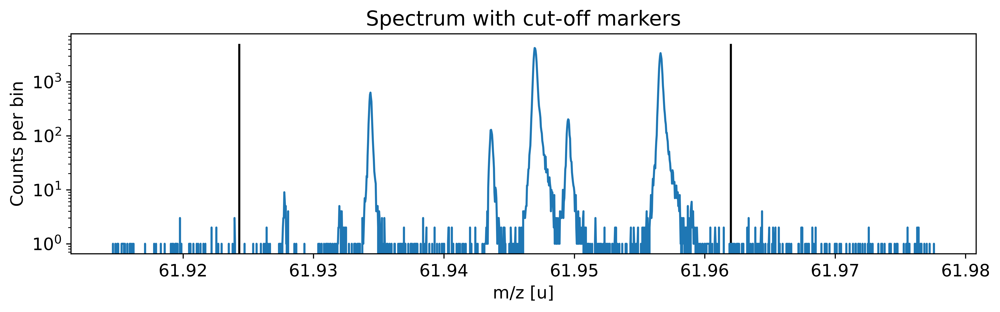

In [2]:
### Import mass data, plot full spectrum and indicate chosen fit range
filename = "2019-09-13_004-_006 SUMMED High stats 62Ga"
skiprows = 38 # number of header rows to skip upon data import
m_start = 61.9243 # low-mass cut off
m_stop = 61.962 # high-mass cut off

spec = emg.spectrum(filename+'.txt',m_start,m_stop,skiprows=skiprows)

## Add peaks to the spectrum 
This can be done with the automatic peak detection spectrum method) and/or by manually adding peaks ([add_peak()](modules.rst#emgfit.spectrum.spectrum.add_peak) spectrum method). The plots shown below are (optional) outputs of the  [detect_peaks()](modules.rst#emgfit.spectrum.spectrum.detect_peaks) method and depicts the different stages of the automatic peak detection.

All information about the peaks associated with the spectrum are compiled in the peak properties table. The table's left-most column shows the respective peak indeces. In all fits, the peaks' `x_pos` will be used as the initial values for the peak position parameters `mu` (to be exact: `mu` marks the centroid of the underlying Gaussians). 

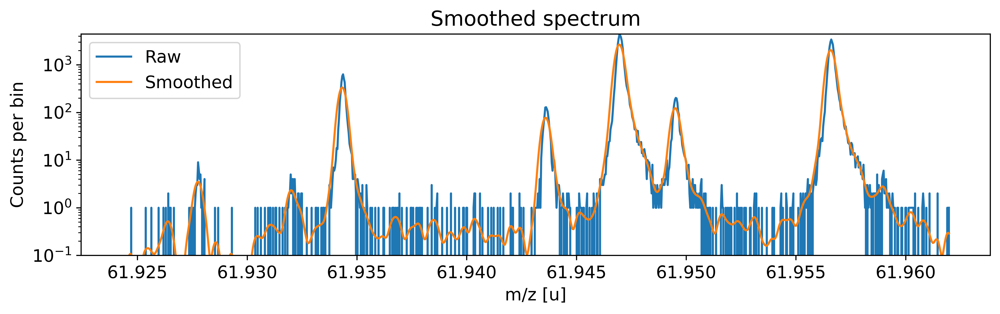

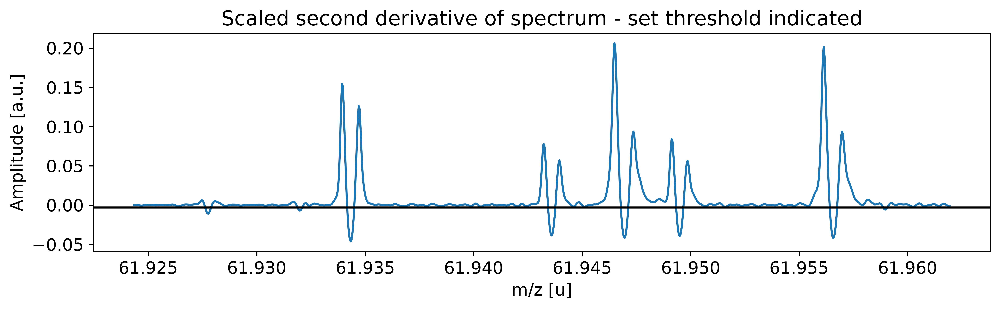

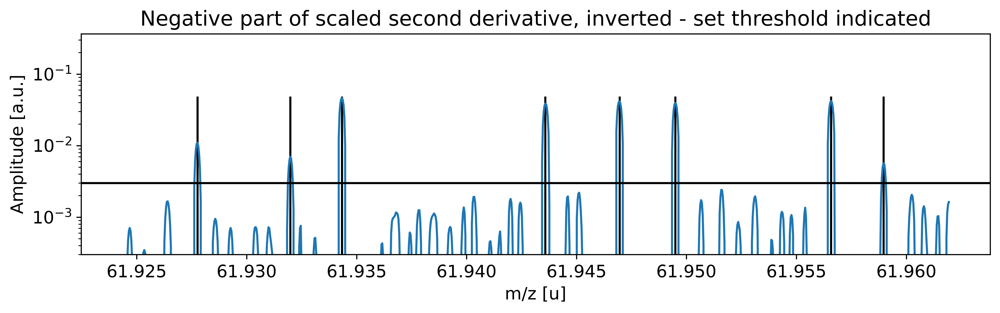

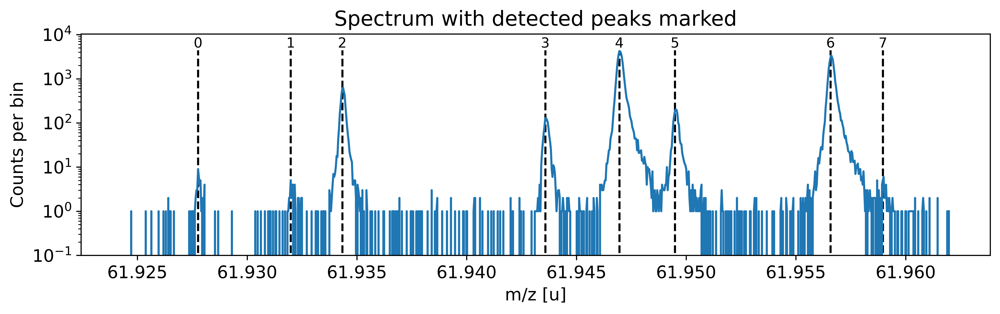

Peak properties table after peak detection:


,x_pos,species,comment,m_AME,m_AME_error,extrapolated,fit_model,cost_func,red_chi,area,area_error,m_ion,rel_stat_error,rel_recal_error,rel_peakshape_error,rel_mass_error,A,atomic_ME_keV,mass_error_keV,m_dev_keV
0,61.927764,?,-,None,None,False,None,None,None,None,None,None,None,None,None,None,None,None,None,None
1,61.931984,?,-,None,None,False,None,None,None,None,None,None,None,None,None,None,None,None,None,None
2,61.934333,?,-,None,None,False,None,None,None,None,None,None,None,None,None,None,None,None,None,None
3,61.943581,?,-,None,None,False,None,None,None,None,None,None,None,None,None,None,None,None,None,None
4,61.946958,?,-,None,None,False,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5,61.949490,?,-,None,None,False,None,None,None,None,None,None,None,None,None,None,None,None,None,None
6,61.956574,?,-,None,None,False,None,None,None,None,None,None,None,None,None,None,None,None,None,None
7,61.958960,?,-,None,None,False,None,None,None,None,None,None,None,None,None,None,None,None,None,None


In [3]:
### Detect peaks and add them to spectrum object 'spec'
spec.detect_peaks() # automatic peak detection
#spec.add_peak(61.925,species='?') # manually add a peak at x_pos = 61.925u
#spec.remove_peak(peak_index=0) # manually remove the peak with index 0 

## Assign species to the peaks (optional)
Although this step is optional, it is highly recommended that it is not skipped. By assigning species labels to your peaks you do not only gain more overview over your spectrum, but also allow for literature values to be automatically fetched from the AME database and entered into the peak properties table. Once a `species` label has been assigned, you can refer to this peak not only via its index but also via the label.

The [assign_species()](modules.rst#emgfit.spectrum.spectrum.assign_species) method allows to assign species identifications either to a single selected peak or to all peaks at once. Here the second option was used by passing a list of species labels to [assign_species()](modules.rst#emgfit.spectrum.spectrum.assign_species). The list must have the same length as the number of peaks associated with the spectrum object. If there are peaks whose labels should not be changed (e.g. unidentified peaks), simply insert ``None`` as a placeholder at the corresponding spots (as done for peaks 2 and 7 below). The syntax for species labels follows the [:-notation](concepts.rst#notation-of-chemical-substances). **It is important not to forget to subtract the number of electrons corresponding to the ion's charge state!** Otherwise the analysis would mistakenly proceed with the atomic instead of the ionic mass. Note that currently only singly charged species are supported by emgfit. Tentative peak identifications can be indicated by adding a ``'?'`` to the end of the species string. In this case the literature values are not fetched. The user can also define custom literature values (e.g. to handle isomers or if there are recent measurements that have not entered the AME yet). For more details see the documentation of [assign_species()](modules.rst#emgfit.spectrum.spectrum.assign_species).   

This is also a good point in time to add any comments to the peaks using the [add_peak_comment()](modules.rst#emgfit.spectrum.spectrum.add_peak_comment) method. These comments can be particularly helpful for post-processing in Excel since they are also written into the output file with the fit results (as is the entire peak properties table). More general comments that concern the entire spectrum can instead be added with the [add_spectrum_comment()](modules.rst#emgfit.spectrum.spectrum.add_spectrum_comment) method. 

In [4]:
### Assign species and add peak comments
spec.assign_species(['Ni62:-1e','Cu62:-1e?',None,'Ga62:-1e','Ti46:O16:-1e','Sc46:O16:-1e','Ca43:F19:-1e',None])
spec.add_peak_comment('Non-isobaric',peak_index=2)
spec.show_peak_properties() # check the changes by printing the peak properties table

Species of peak 0 assigned as Ni62:-1e
Species of peak 1 assigned as Cu62:-1e?
Species of peak 3 assigned as Ga62:-1e
Species of peak 4 assigned as Ti46:O16:-1e
Species of peak 5 assigned as Sc46:O16:-1e
Species of peak 6 assigned as Ca43:F19:-1e
Comment of peak 2 was changed to:  Non-isobaric


,x_pos,species,comment,m_AME,m_AME_error,extrapolated,fit_model,cost_func,red_chi,area,area_error,m_ion,rel_stat_error,rel_recal_error,rel_peakshape_error,rel_mass_error,A,atomic_ME_keV,mass_error_keV,m_dev_keV
0,61.927764,Ni62:-1e,-,61.927796,0.000000,False,None,None,None,None,None,None,None,None,None,None,62,None,None,None
1,61.931984,Cu62:-1e?,-,61.932046,0.000001,False,None,None,None,None,None,None,None,None,None,None,62,None,None,None
2,61.934333,?,Non-isobaric,nan,nan,False,None,None,None,None,None,None,None,None,None,None,nan,None,None,None
3,61.943581,Ga62:-1e,-,61.943641,0.000001,False,None,None,None,None,None,None,None,None,None,None,62,None,None,None
4,61.946958,Ti46:O16:-1e,-,61.946993,0.000000,False,None,None,None,None,None,None,None,None,None,None,62,None,None,None
5,61.949490,Sc46:O16:-1e,-,61.949534,0.000001,False,None,None,None,None,None,None,None,None,None,None,62,None,None,None
6,61.956574,Ca43:F19:-1e,-,61.956621,0.000000,False,None,None,None,None,None,None,None,None,None,None,62,None,None,None
7,61.958960,?,-,nan,nan,False,None,None,None,None,None,None,None,None,None,None,nan,None,None,None


## Activate hiding of mass values for blind analysis (optional)

By adding peak indeces to the spectrum's `blinded_peaks` list, the obtained masses and positions of selected peaks-of-interest can be hidden from the user. This blindfolding can avoid user bias and is automatically lifted once the results are exported.  

In [5]:
### Optionally turn on blinding of specific peaks of interest to enable blind analysis 
spec.set_blinded_peaks([0,3]) # activate blinding for peaks 0 & 3
#spec.set_blinded_peaks([],overwrite=True) # run this to deactivate blinding for all peaks

Blinding is activated for peaks: 0, 3


## Select the optimal fit model and perform the peak-shape calibration 
Next we need to find both a fit model and a set of model parameters that capture the shape of our peaks as well as possible. In emgfit both of this is achieved with the [determine_peak_shape()](modules.rst#emgfit.spectrum.spectrum.determine_peak_shape) method. Once the peak-shape calibration has been performed all subsequent fits will be performed with this fixed peak-shape, by only varying the peak centroids, amplitudes and optionally the uniform-baseline parameter `bkg_c`.

By default [determine_peak_shape()](modules.rst#emgfit.spectrum.spectrum.determine_peak_shape) performs an **automatic model selection** in which the shape-calibrant peak is first fitted with a pure Gaussian and then with Hyper-EMG functions with an increasing number of expontential tails on the left and right. The algorithm selects the fit model which yields the smallest $\chi^2_\text{red}$ without having any of the tail weight parameters $\eta$ compatible with zero within their uncertainty. Alternatively, the auto-model selection can be turned off with the argument `vary_tail_order=False` and the fit model can be selected manually with the `fit_model` argument.

Once the best fit model has been selected the method proceeds with the determination of the peak-shape parameters and shows a detailed report with the fit results. 

Some recommendations:

- It is recommended to do the peak-shape calibration with a chi-squared fit (default) since this yields more robust     results and more trusworthy parameter uncertainty estimates. Check the method docs for info on performing the shape calibration with binned maximum likelihood estimation.
- Ideally the peak-shape calibration is performed on a well-separated peak with high statistics. In this example, the `Ca43:F19:-1e` peak was selected as peak-shape calibrant. Since the default fit range includes a smaller peak on the right, the range was manually reduced to 0.45u with the `x_fit_range` argument. If unavoidable, the peak-shape determination can also be performed on partially overlapping peaks since emgfit ensures identical shape parameters for all peaks being fitted. 


##### Determine optimal tail order #####


### Fitting data with Gaussian ###---------------------------------------------------------------------------------------------



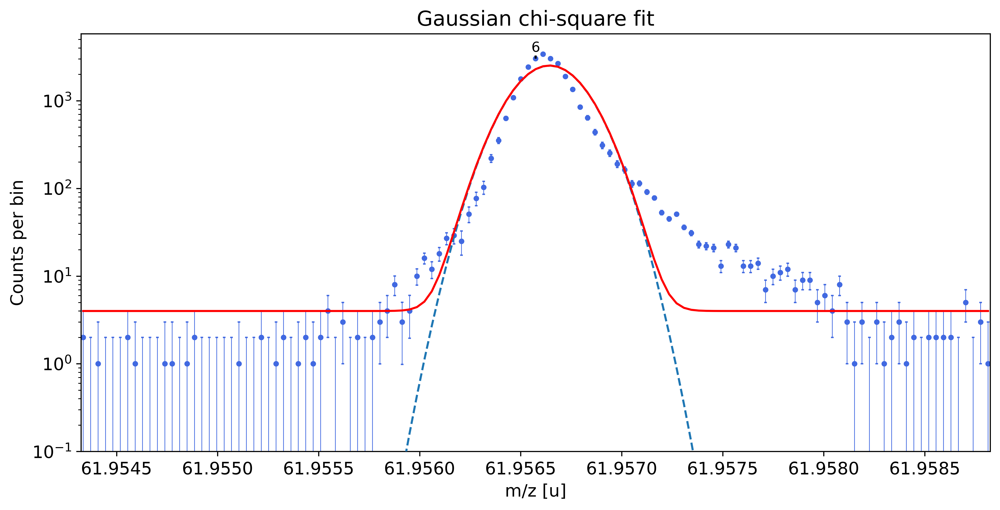

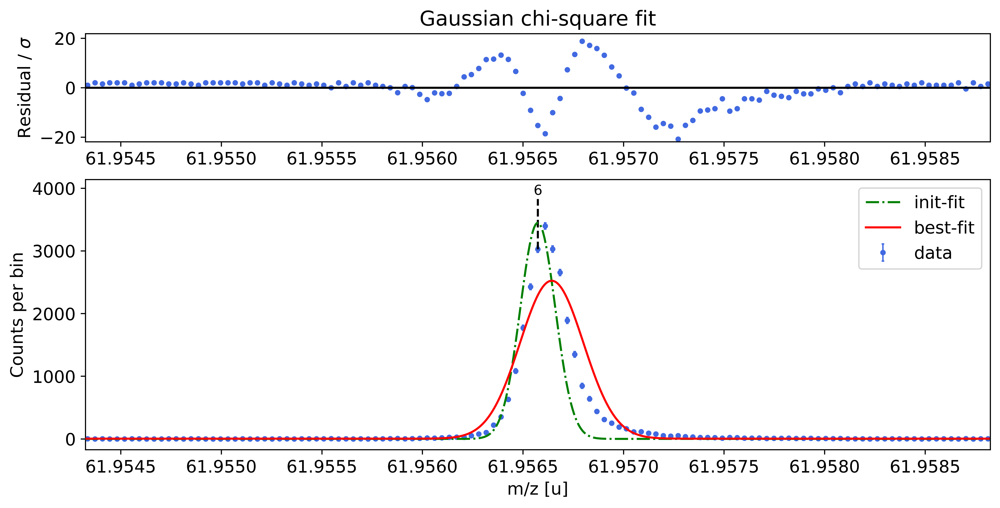


Gaussian-fit yields reduced chi-square of: 45.57 +- 0.13


### Fitting data with emg01 ###---------------------------------------------------------------------------------------------



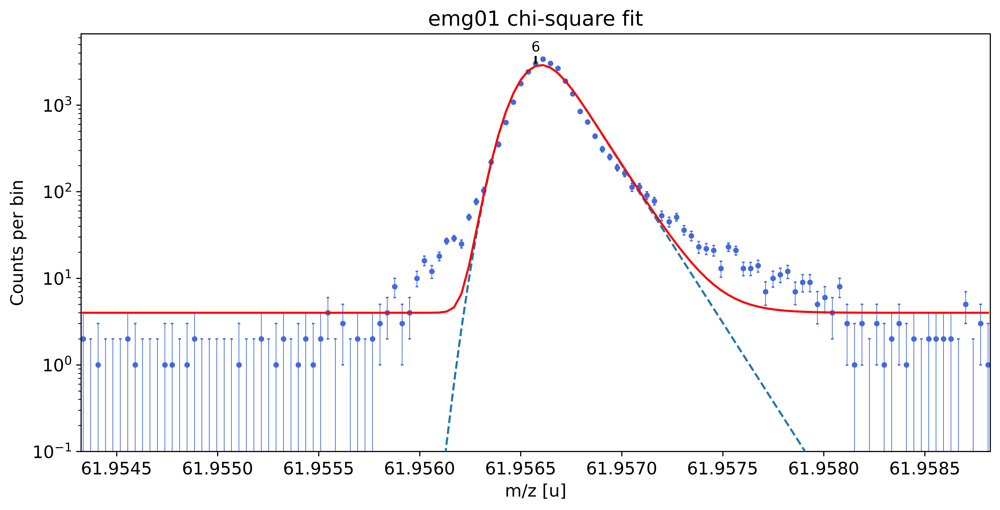

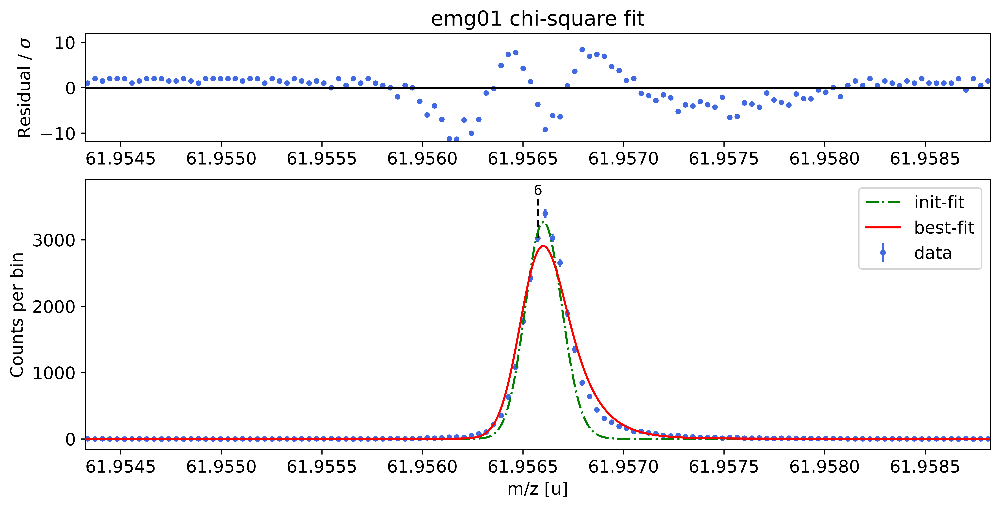


emg01-fit yields reduced chi-square of: 13.79 +- 0.13


### Fitting data with emg10 ###---------------------------------------------------------------------------------------------



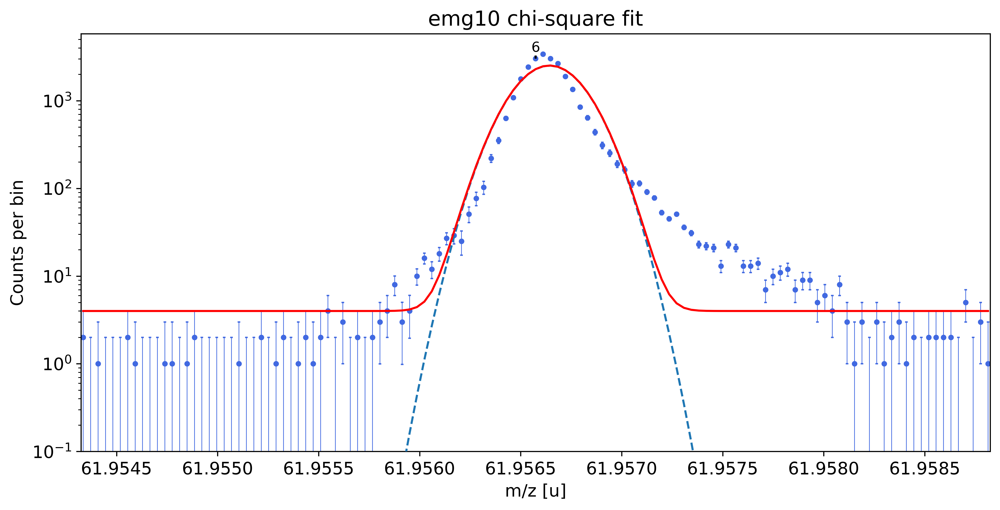

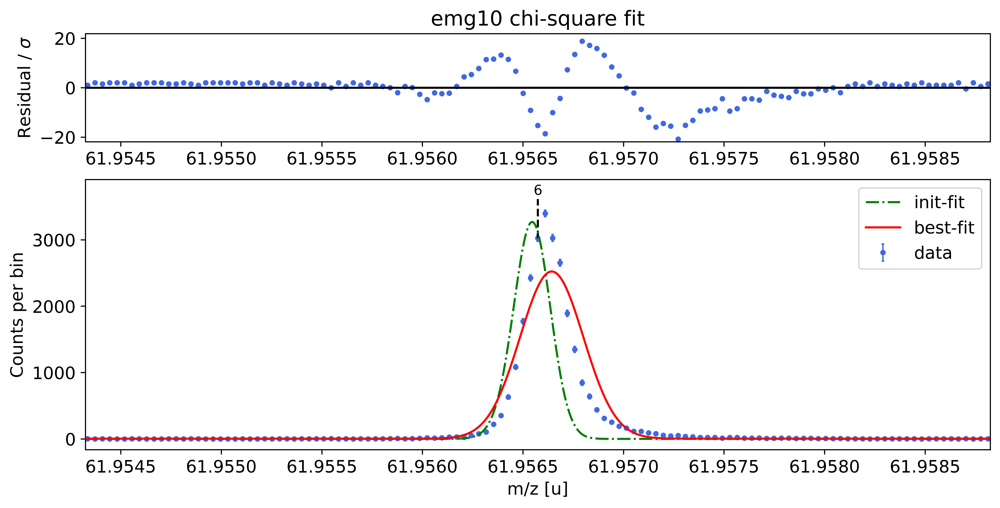


emg10-fit yields reduced chi-square of: 45.96 +- 0.13


### Fitting data with emg11 ###---------------------------------------------------------------------------------------------



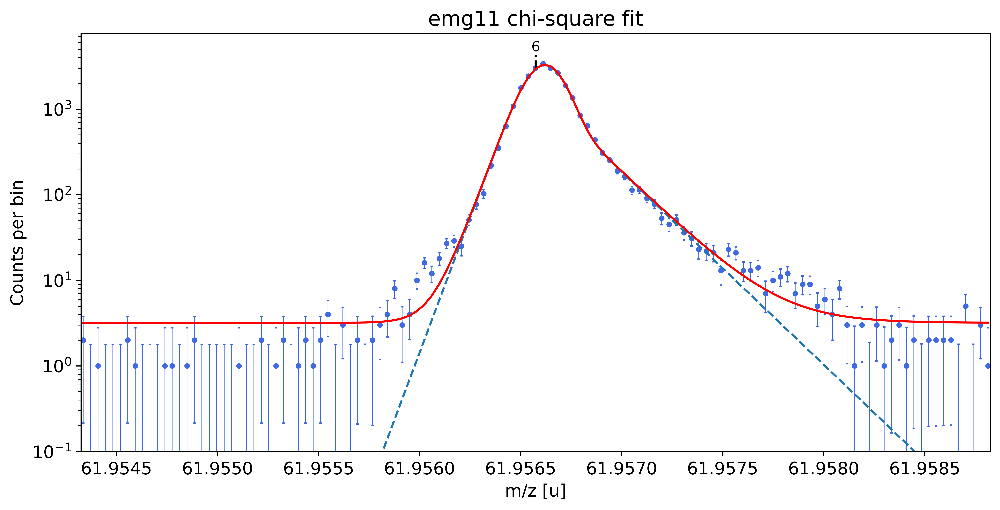

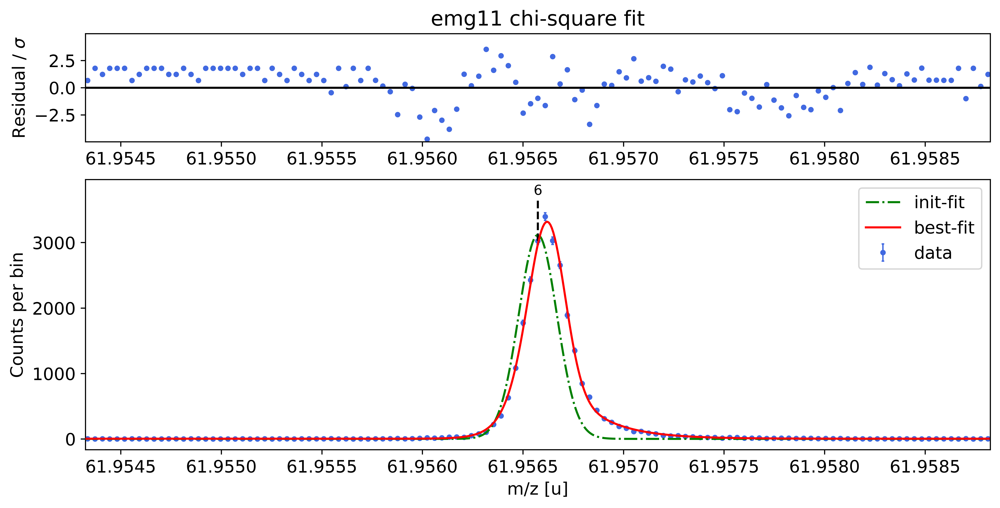


emg11-fit yields reduced chi-square of: 2.6 +- 0.13


### Fitting data with emg12 ###---------------------------------------------------------------------------------------------



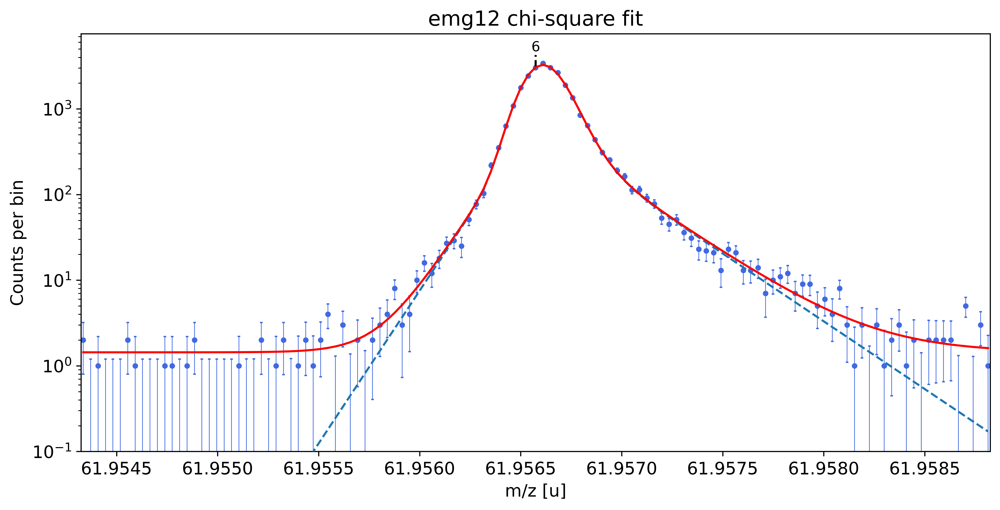

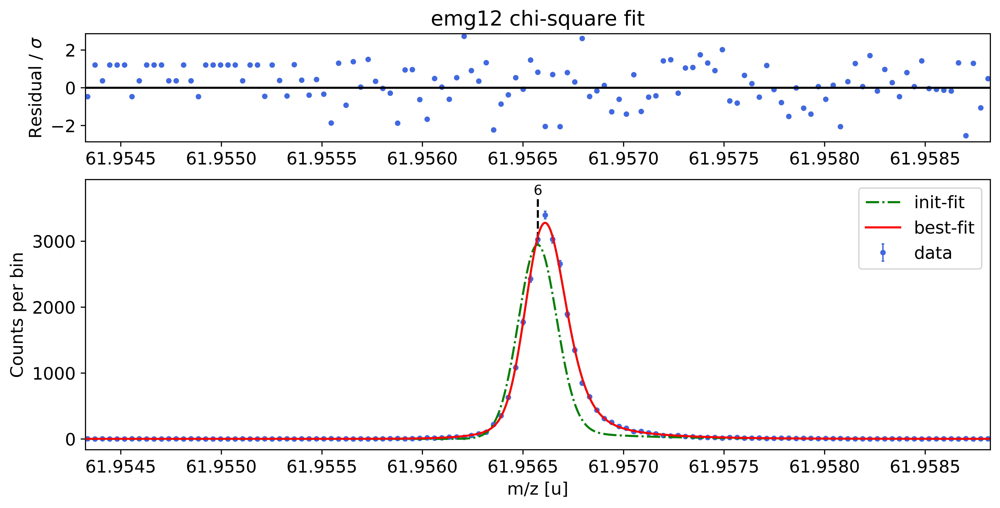


emg12-fit yields reduced chi-square of: 1.22 +- 0.13


### Fitting data with emg21 ###---------------------------------------------------------------------------------------------



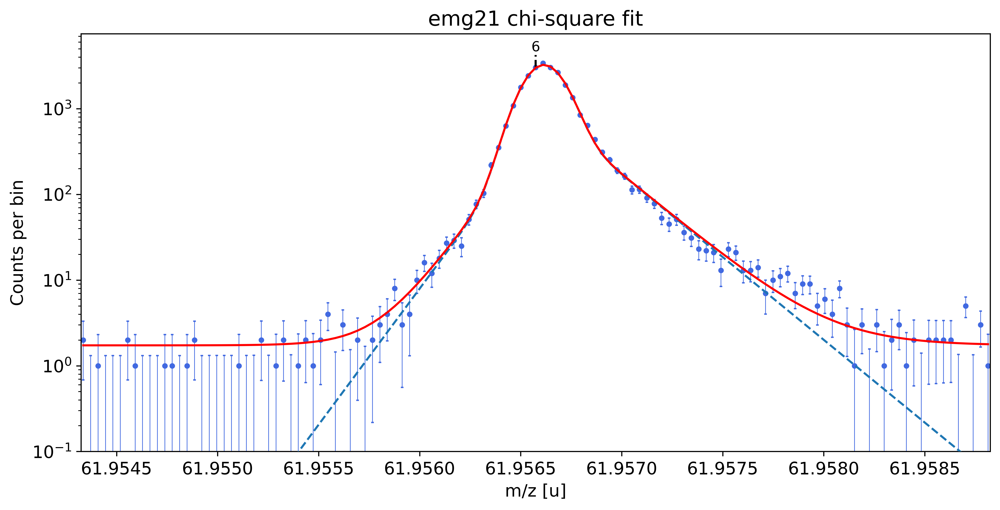

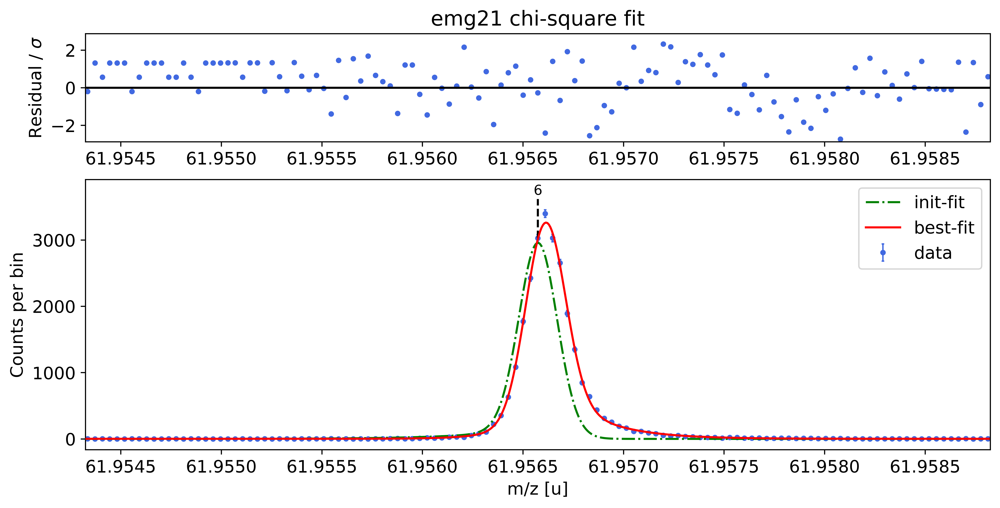

             This tail order is likely overfitting the data and will be excluded from selection.

emg21-fit yields reduced chi-square of: 1.47 +- 0.13


### Fitting data with emg22 ###---------------------------------------------------------------------------------------------



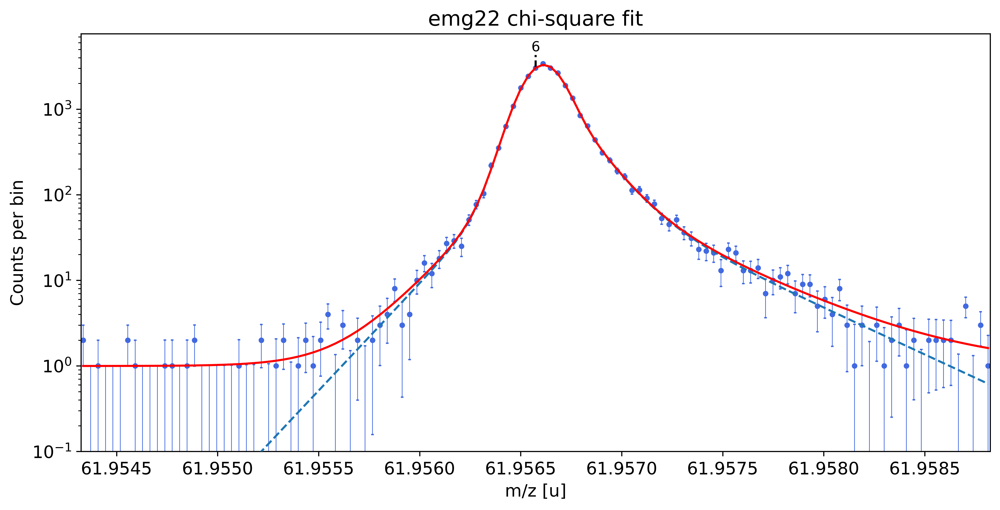

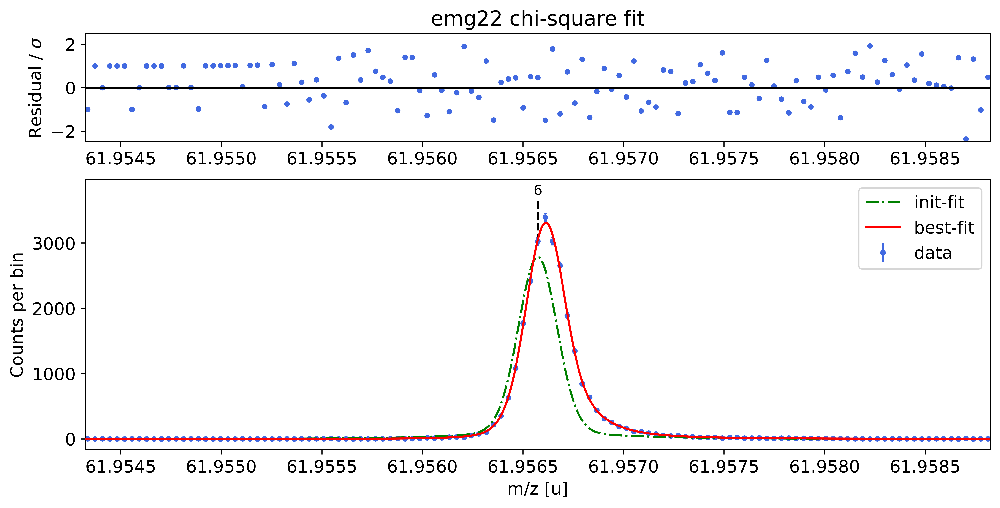


emg22-fit yields reduced chi-square of: 0.97 +- 0.13


### Fitting data with emg23 ###---------------------------------------------------------------------------------------------



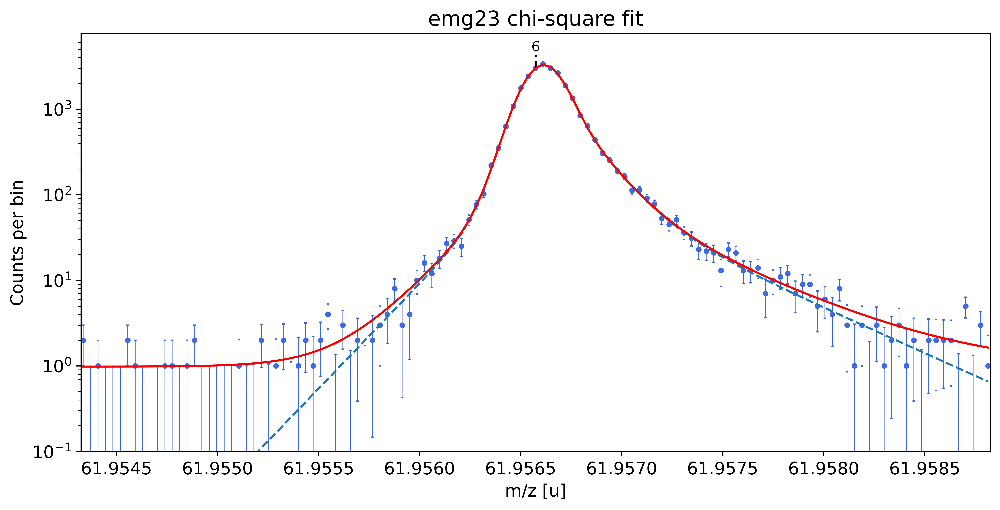

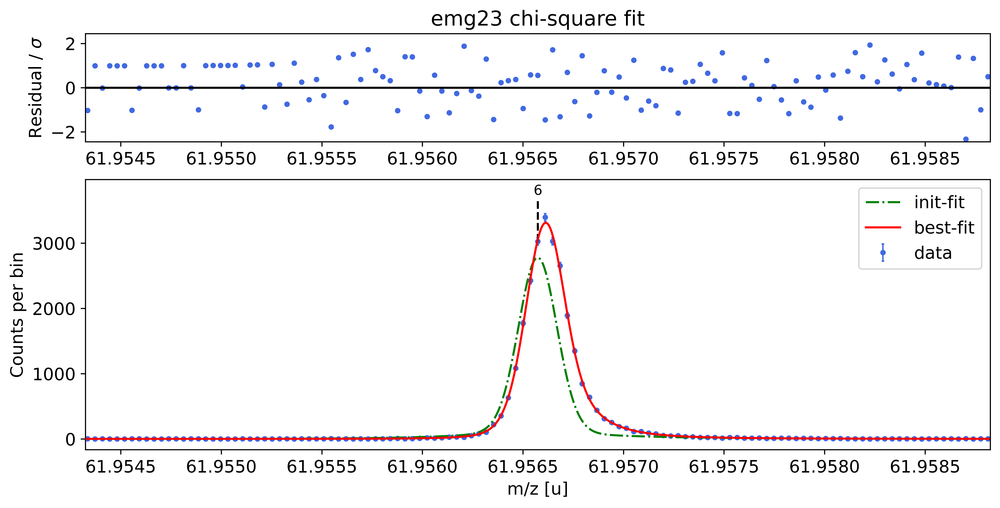

             This tail order is likely overfitting the data and will be excluded from selection.

emg23-fit yields reduced chi-square of: 0.99 +- 0.13


### Fitting data with emg32 ###---------------------------------------------------------------------------------------------



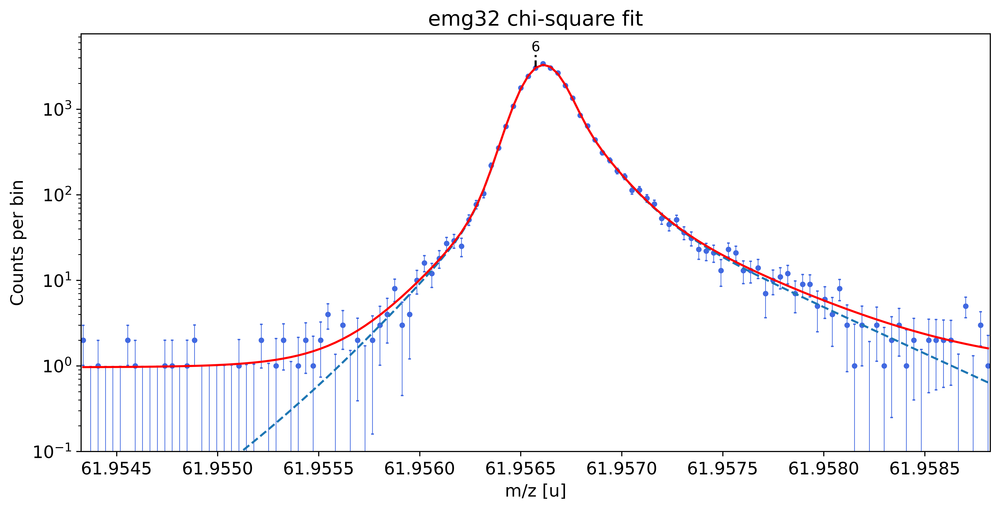

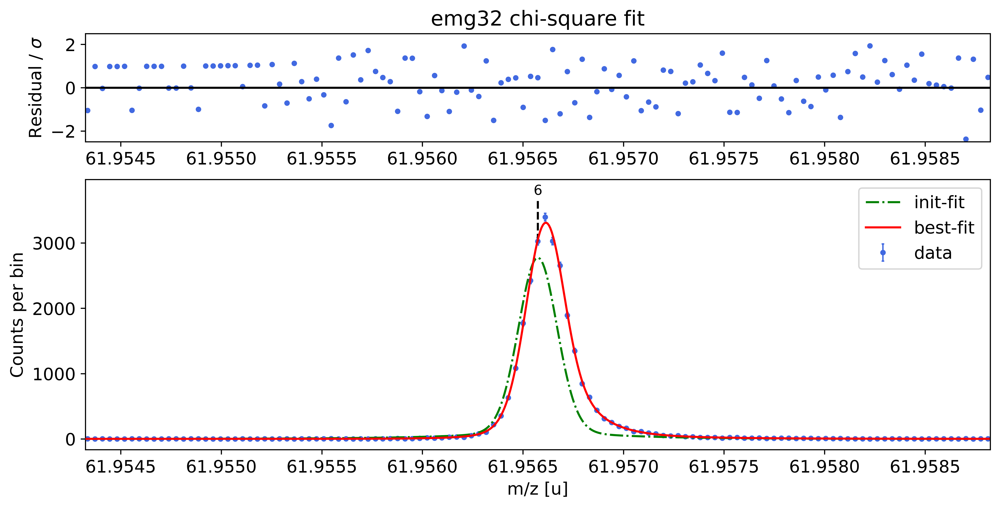

             This tail order is likely overfitting the data and will be excluded from selection.

emg32-fit yields reduced chi-square of: 0.99 +- 0.13


### Fitting data with emg33 ###---------------------------------------------------------------------------------------------



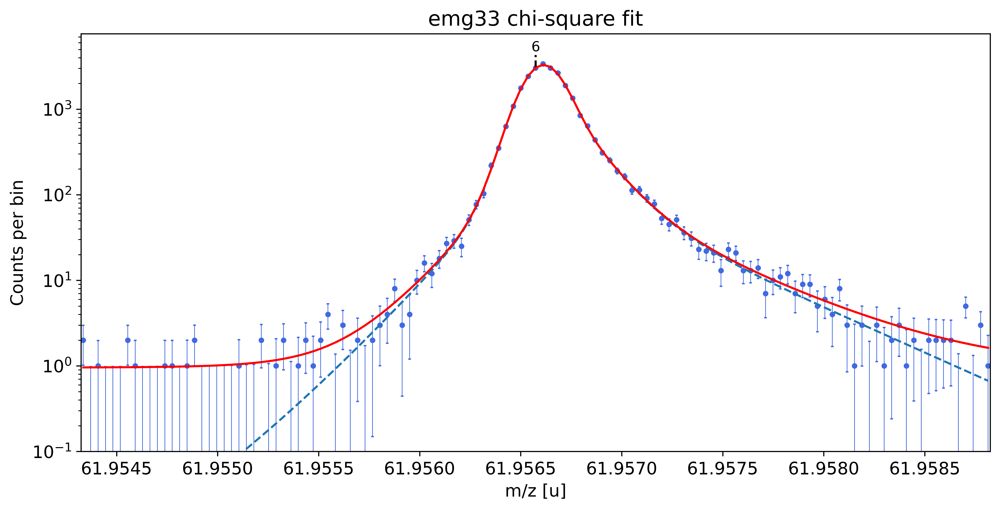

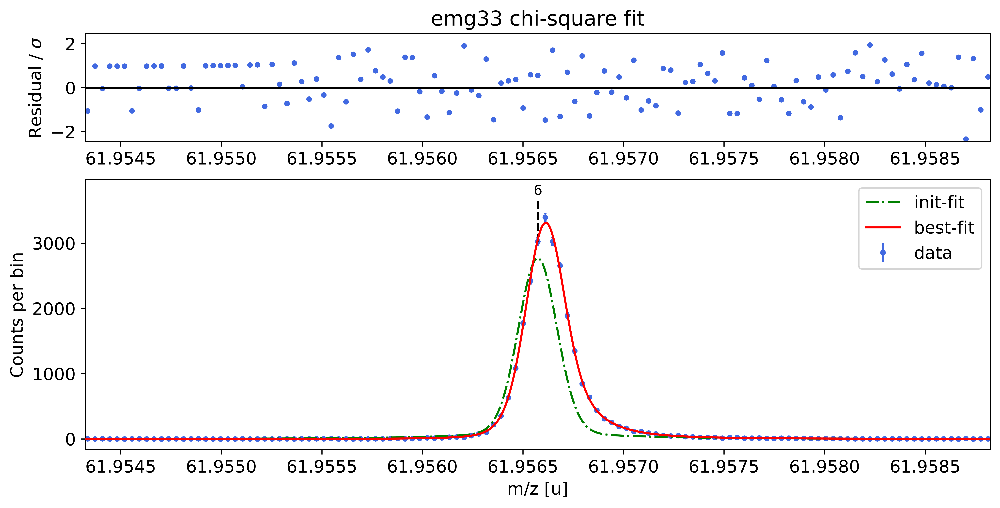

             This tail order is likely overfitting the data and will be excluded from selection.

emg33-fit yields reduced chi-square of: 1.01 +- 0.14


##### RESULT OF AUTOMATIC MODEL SELECTION: #####

    Best fit model determined to be:  emg22
    Corresponding chi²-reduced:  0.97 +- 0.13


##### Peak-shape determination #####-------------------------------------------------------------------------------------------


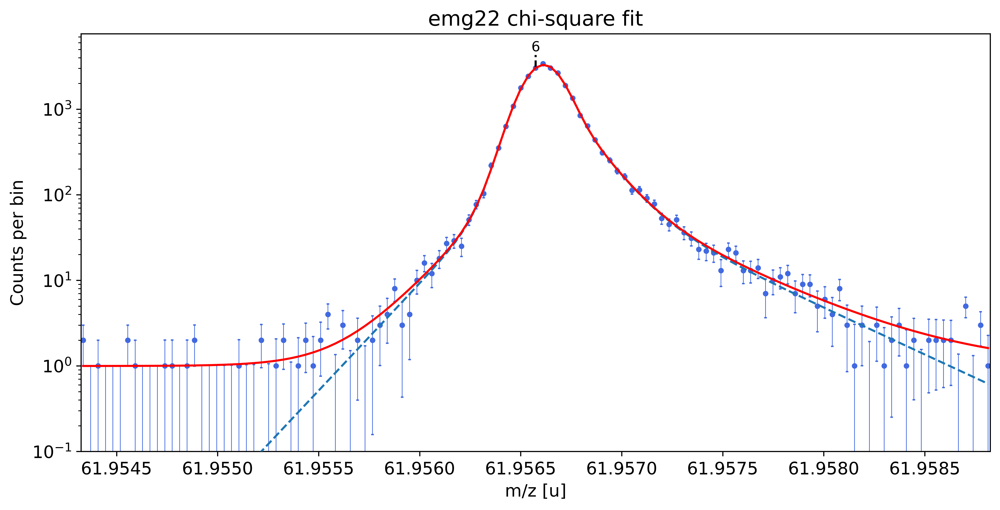

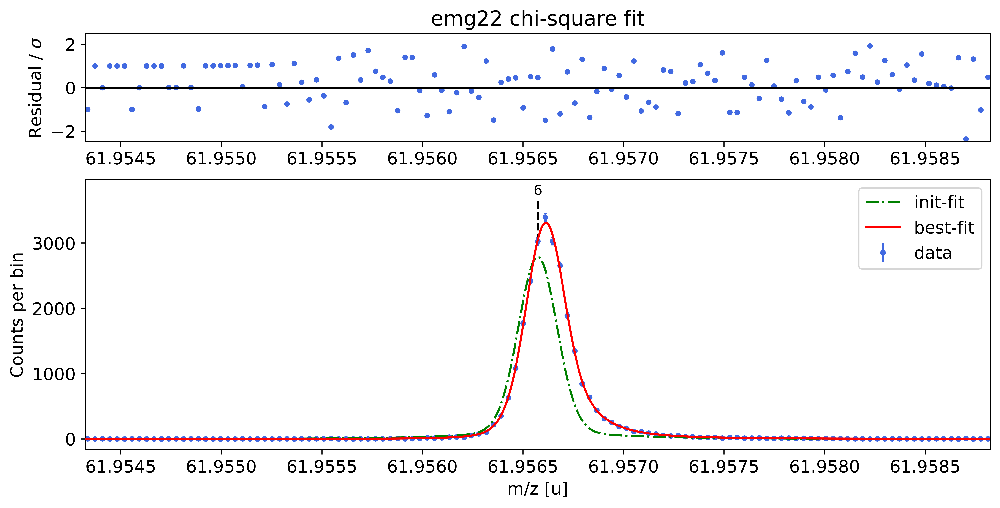

In [6]:
## Peak-shape calibration with default settings, including automatic model selection:
#spec.determine_peak_shape(species_shape_calib='Ca43:F19:-1e') 

## Peak-shape calibration with user-defined fit range:
spec.determine_peak_shape(species_shape_calib='Ca43:F19:-1e',x_fit_range=0.0045) 

## Peak-shape calibration with user-defined fit model:
#spec.determine_peak_shape(species_shape_calib='Ca43:F19:-1e',fit_model='emg12',vary_tail_order=False)

## Determine A_stat_emg for subsequent stat. error estimations (optional)

By default, the statistical uncertainties of Hyper-EMG fits are estimated using the equation:

$\sigma_{stat} = A_{stat,emg} \cdot \frac{\mathrm{FWHM}}{\sqrt{N_{counts}}}$

where $\mathrm{FWHM}$ and $N_{counts}$ refer to the full width at half maximum and the number of counts in the respective peak. **This step can be skipped when the statistical uncertainties are estimated using the get_errors_from_resampling() method (see "Perform parametric bootstrap to get refined statistical uncertainties" section below).**

By default a of value $A_{stat,emg} = 0.52$ will be used for Hyper-EMG models (for Gaussians $A_{stat,G}=0.425$).

However, $A_{stat,emg}$ depends on the peak-shape and can deviate from the default value. Therefore, the [determine_A_stat_emg()](modules.rst#emgfit.spectrum.spectrum.determine_A_stat_emg) method can be used to estimate $A_{stat,emg}$ for the specific peak shape in the spectrum. This is done by fitting many simulated spectra created via bootstrap re-sampling from a reference peak in the spectrum. The reference peak should be well-separated and have decent statistics (e.g. the peak-shape calibrant). For details on how $A_{stat,emg}$ is estimated see the linked docs of [determine_A_stat_emg()](modules.rst#emgfit.spectrum.spectrum.determine_A_stat_emg).

This method will typically run for ~10 minutes if `N_spectra=1000` (default) is used. For demonstration purposes here the number of bootstrapped spectra generated for each data point (`N_spectra` argument) was reduced to 10 to get a quicker run time. This is also the reason for the large scatter of the data points below. 

In practice it is convenient to skip this method for the first processing of the spectrum since this will only affect the statistical uncertainties but no other fit properties. Once reasonable fits have been achieved for all peaks of interest in the cells below, the exact uncertainties can be obtained by returning to this cell to execute [determine_A_stat_emg()](modules.rst#emgfit.spectrum.spectrum.determine_A_stat_emg) with a decent value for `N_spectra`  and then re-runnning the cells below (then with the update value for [determine_A_stat_emg()](modules.rst#emgfit.spectrum.spectrum.determine_A_stat_emg)). The latter is conveniently done by using the `Run All Below` option in the `Cell` panel of the Jupyter Notebook. 

Creating synthetic spectra via bootstrap re-sampling and fitting them for A_stat determination.
Depending on the choice of `N_spectra` this can take a few minutes. Interrupt kernel if this takes too long.



Done!

[[Model]]
    Model(powerlaw)
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 5
    # data points      = 8
    # variables        = 1
    chi-square         = 9.4271e-09
    reduced chi-square = 1.3467e-09
    Akaike info crit   = -162.472956
    Bayesian info crit = -162.393514
[[Variables]]
    amplitude:  1.3228e-04 +/- 1.2963e-05 (9.80%) (init = 1)
    exponent:  -0.5 (fixed)


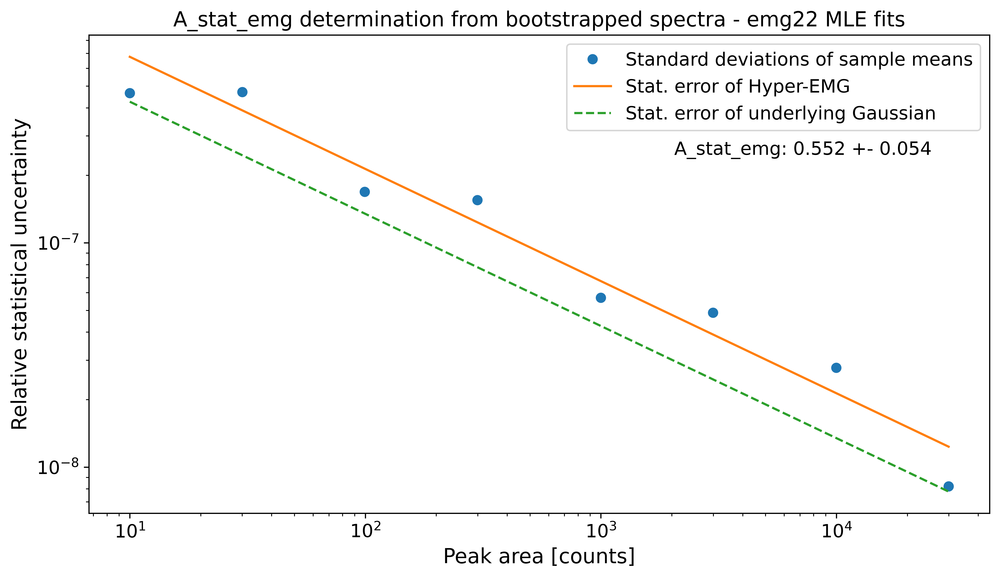

A_stat of a Gaussian model: 0.425
Default A_stat_emg for Hyper-EMG models: 0.52
A_stat_emg for this spectrum's emg22 fit model: 0.552 +- 0.054


In [7]:
# Determine A_stat_emg and save the resulting plot
# In actual practice N_spectra >= 1000 should be used
spec.determine_A_stat_emg(species='Ca43:F19:-1e', x_range=0.004, plot_filename='outputs/'+filename+'_MLE', N_spectra=10) 

## Fit all peaks, perform mass re-calibration & obtain final mass values
The following code fits all peaks in the spectrum, performs the mass (re-)calibration, determines the peak-shape uncertainties and updates the peak properties list with the results including the final mass values and their uncertainties. 

The simultaneous mass recalibration is optional and only invoked when the `species_mass_calib` (or the `index_mass_calib`) argument are specified. If this feature is not used, the [fit_peaks()](modules.rst#emgfit.spectrum.spectrum.fit_peaks) method requires a pre-existing mass calibration (see Alternative 1 section below). In contrast to [determine_peak_shape()](modules.rst#emgfit.spectrum.spectrum.determine_peak_shape), by default [fit_peaks()](modules.rst#emgfit.spectrum.spectrum.fit_peaks) performs a binned maximum likelihood fit ('MLE'). For chi-square fitting with [fit_peaks()](modules.rst#emgfit.spectrum.spectrum.fit_peaks) see Alternative 2 section below. Fits with [fit_peaks()](modules.rst#emgfit.spectrum.spectrum.fit_peaks) can be restricted to a user-defined mass range or to groups of neighbouring peaks selected by index (see the commented-out lines below). 

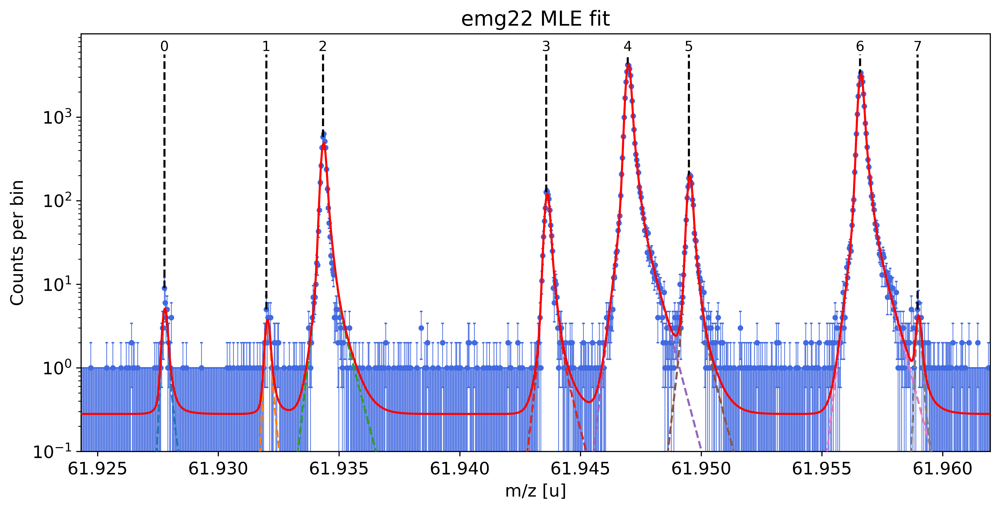

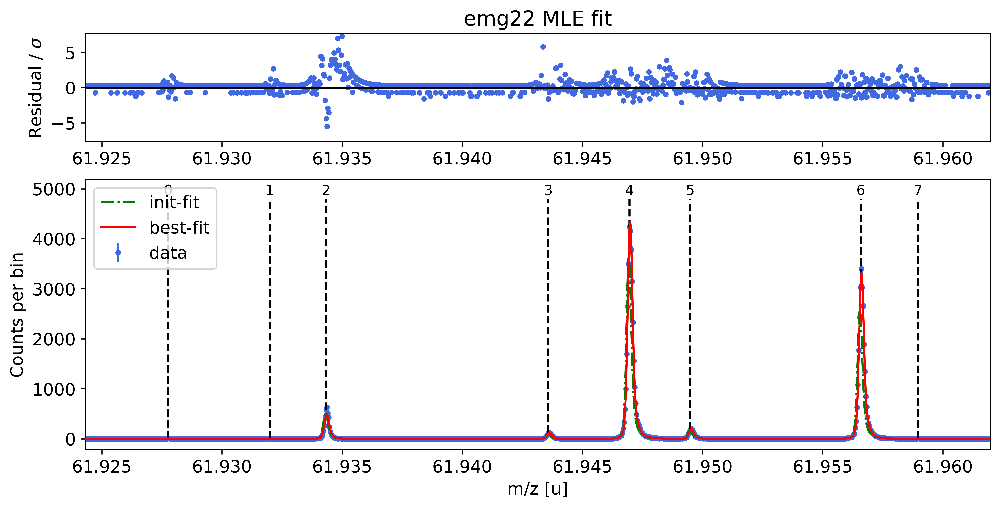


##### Mass recalibration #####

Relative literature error of mass calibrant:     2.8e-09
Relative statistical error of mass calibrant:    1.2e-08

Recalibration factor:    0.999999717 = 1 -2.8e-07
Relative recalibration error:    1.2e-08 


##### Peak-shape uncertainty evaluation #####

Determining centroid shifts of mass calibrant.

All mass shifts below are corrected for the corresponding shifts of the mass calibrant peak.



Re-fitting with sigma  =  8.34e-05 +/- 3.02e-06 shifts peak  0 by  -0.24  /   0.18 μu  & its area by   0.1 /  -0.1 counts.
Re-fitting with sigma  =  8.34e-05 +/- 3.02e-06 shifts peak  1 by   0.44  /  -0.45 μu  & its area by   0.1 /  -0.1 counts.
Re-fitting with sigma  =  8.34e-05 +/- 3.02e-06 shifts peak  2 by  -0.34  /   0.27 μu  & its area by   0.2 /  -0.2 counts.
Re-fitting with sigma  =  8.34e-05 +/- 3.02e-06 shifts peak  3 by  -0.07  /  -0.01 μu  & its area by   0.2 /  -0.2 counts.
Re-fitting with sigma  =  8.34e-05 +/- 3.02e-06 shifts peak  5 by  -0.06  /  -0.03 μu  & its area by   0.5 /  -0.6 counts.
Re-fitting with sigma  =  8.34e-05 +/- 3.02e-06 shifts peak  6 by  -0.02  /  -0.04 μu  & its area by   0.3 /  -0.4 counts.
Re-fitting with sigma  =  8.34e-05 +/- 3.02e-06 shifts peak  7 by  -0.19  /   0.03 μu  & its area by   0.2 /  -0.2 counts.



Re-fitting with theta  =  7.23e-01 +/- 2.43e-02 shifts peak  0 by  -0.99  /   0.48 μu  & its area by  -0.2 /   0.2 counts.
Re-fitting with theta  =  7.23e-01 +/- 2.43e-02 shifts peak  1 by  -1.22  /   1.00 μu  & its area by  -0.4 /   0.3 counts.
Re-fitting with theta  =  7.23e-01 +/- 2.43e-02 shifts peak  2 by  -0.32  /   0.36 μu  & its area by  -0.6 /   0.6 counts.
Re-fitting with theta  =  7.23e-01 +/- 2.43e-02 shifts peak  3 by  -0.28  /   0.10 μu  & its area by  -1.3 /   0.8 counts.
Re-fitting with theta  =  7.23e-01 +/- 2.43e-02 shifts peak  5 by  -0.25  /   0.21 μu  & its area by  -0.3 /   0.1 counts.
Re-fitting with theta  =  7.23e-01 +/- 2.43e-02 shifts peak  6 by  -0.05  /   0.03 μu  & its area by  -2.8 /   2.1 counts.
Re-fitting with theta  =  7.23e-01 +/- 2.43e-02 shifts peak  7 by  -2.85  /   1.81 μu  & its area by   0.1 /  -0.2 counts.



Re-fitting with eta_m1 =  9.17e-01 +/- 2.43e-02 shifts peak  0 by   0.71  /  -1.10 μu  & its area by  -0.4 /   0.3 counts.
Re-fitting with eta_m1 =  9.17e-01 +/- 2.43e-02 shifts peak  1 by   0.30  /  -0.38 μu  & its area by  -0.4 /   0.3 counts.
Re-fitting with eta_m1 =  9.17e-01 +/- 2.43e-02 shifts peak  2 by   0.41  /  -0.33 μu  & its area by  -1.9 /   1.4 counts.
Re-fitting with eta_m1 =  9.17e-01 +/- 2.43e-02 shifts peak  3 by   0.29  /  -0.29 μu  & its area by  -1.1 /   0.8 counts.
Re-fitting with eta_m1 =  9.17e-01 +/- 2.43e-02 shifts peak  5 by   0.24  /  -0.23 μu  & its area by  -4.0 /   3.0 counts.
Re-fitting with eta_m1 =  9.17e-01 +/- 2.43e-02 shifts peak  6 by   0.00  /  -0.09 μu  & its area by  -4.5 /   1.9 counts.
Re-fitting with eta_m1 =  9.17e-01 +/- 2.43e-02 shifts peak  7 by   0.50  /  -1.02 μu  & its area by  -0.5 /   0.4 counts.



Re-fitting with tau_m1 =  4.45e-05 +/- 6.08e-06 shifts peak  0 by  -0.90  /   0.79 μu  & its area by   0.2 /  -0.2 counts.
Re-fitting with tau_m1 =  4.45e-05 +/- 6.08e-06 shifts peak  1 by   0.24  /  -0.30 μu  & its area by   0.2 /  -0.2 counts.
Re-fitting with tau_m1 =  4.45e-05 +/- 6.08e-06 shifts peak  2 by  -0.48  /   0.43 μu  & its area by   0.4 /  -0.3 counts.
Re-fitting with tau_m1 =  4.45e-05 +/- 6.08e-06 shifts peak  3 by  -0.14  /   0.06 μu  & its area by   0.4 /  -0.4 counts.
Re-fitting with tau_m1 =  4.45e-05 +/- 6.08e-06 shifts peak  5 by  -0.16  /   0.07 μu  & its area by   1.0 /  -0.8 counts.
Re-fitting with tau_m1 =  4.45e-05 +/- 6.08e-06 shifts peak  6 by  -0.01  /  -0.02 μu  & its area by   0.5 /  -0.5 counts.
Re-fitting with tau_m1 =  4.45e-05 +/- 6.08e-06 shifts peak  7 by  -1.00  /   0.91 μu  & its area by   0.3 /  -0.2 counts.



Re-fitting with tau_m2 =  1.73e-04 +/- 2.43e-05 shifts peak  0 by  -0.07  /   0.53 μu  & its area by   0.3 /  -0.4 counts.
Re-fitting with tau_m2 =  1.73e-04 +/- 2.43e-05 shifts peak  1 by  -0.12  /   0.10 μu  & its area by   0.4 /  -0.5 counts.
Re-fitting with tau_m2 =  1.73e-04 +/- 2.43e-05 shifts peak  2 by  -0.26  /   0.15 μu  & its area by   1.9 /  -2.6 counts.
Re-fitting with tau_m2 =  1.73e-04 +/- 2.43e-05 shifts peak  3 by  -0.15  /   0.20 μu  & its area by   0.8 /  -1.2 counts.
Re-fitting with tau_m2 =  1.73e-04 +/- 2.43e-05 shifts peak  5 by  -0.08  /   0.10 μu  & its area by   3.3 /  -4.0 counts.
Re-fitting with tau_m2 =  1.73e-04 +/- 2.43e-05 shifts peak  6 by   0.01  /   0.00 μu  & its area by   5.7 /  -8.0 counts.
Re-fitting with tau_m2 =  1.73e-04 +/- 2.43e-05 shifts peak  7 by   0.09  /  -0.14 μu  & its area by   0.4 /  -0.6 counts.



Re-fitting with eta_p1 =  7.84e-01 +/- 4.71e-02 shifts peak  0 by  -0.08  /   0.06 μu  & its area by  -0.3 /   0.3 counts.
Re-fitting with eta_p1 =  7.84e-01 +/- 4.71e-02 shifts peak  1 by  -0.31  /   0.15 μu  & its area by  -0.5 /   0.4 counts.
Re-fitting with eta_p1 =  7.84e-01 +/- 4.71e-02 shifts peak  2 by  -0.25  /   0.20 μu  & its area by  -1.9 /   1.4 counts.
Re-fitting with eta_p1 =  7.84e-01 +/- 4.71e-02 shifts peak  3 by  -0.15  /   0.10 μu  & its area by  -2.1 /   1.7 counts.
Re-fitting with eta_p1 =  7.84e-01 +/- 4.71e-02 shifts peak  5 by  -0.28  /   0.15 μu  & its area by   0.1 /  -0.6 counts.
Re-fitting with eta_p1 =  7.84e-01 +/- 4.71e-02 shifts peak  6 by  -0.02  /  -0.05 μu  & its area by  -6.7 /   5.1 counts.
Re-fitting with eta_p1 =  7.84e-01 +/- 4.71e-02 shifts peak  7 by  -4.00  /   3.14 μu  & its area by   0.9 /  -0.9 counts.



Re-fitting with tau_p1 =  1.23e-04 +/- 1.37e-05 shifts peak  0 by   0.10  /   0.02 μu  & its area by   0.1 /  -0.1 counts.
Re-fitting with tau_p1 =  1.23e-04 +/- 1.37e-05 shifts peak  1 by   0.37  /  -0.60 μu  & its area by   0.3 /  -0.4 counts.
Re-fitting with tau_p1 =  1.23e-04 +/- 1.37e-05 shifts peak  2 by   0.40  /  -0.47 μu  & its area by   0.4 /  -0.5 counts.
Re-fitting with tau_p1 =  1.23e-04 +/- 1.37e-05 shifts peak  3 by   0.17  /  -0.19 μu  & its area by   0.6 /  -0.6 counts.
Re-fitting with tau_p1 =  1.23e-04 +/- 1.37e-05 shifts peak  5 by   0.02  /  -0.06 μu  & its area by   1.1 /  -1.1 counts.
Re-fitting with tau_p1 =  1.23e-04 +/- 1.37e-05 shifts peak  6 by   0.01  /  -0.01 μu  & its area by   1.0 /   1.5 counts.
Re-fitting with tau_p1 =  1.23e-04 +/- 1.37e-05 shifts peak  7 by   0.37  /  -0.54 μu  & its area by   0.3 /  -0.4 counts.



Re-fitting with tau_p2 =  3.98e-04 +/- 5.34e-05 shifts peak  0 by   0.10  /  -0.02 μu  & its area by   0.4 /  -0.5 counts.
Re-fitting with tau_p2 =  3.98e-04 +/- 5.34e-05 shifts peak  1 by   0.31  /  -0.41 μu  & its area by   0.5 /  -0.6 counts.
Re-fitting with tau_p2 =  3.98e-04 +/- 5.34e-05 shifts peak  2 by  -0.03  /  -0.09 μu  & its area by   2.7 /  -2.9 counts.
Re-fitting with tau_p2 =  3.98e-04 +/- 5.34e-05 shifts peak  3 by   0.03  /  -0.09 μu  & its area by   2.4 /  -2.7 counts.
Re-fitting with tau_p2 =  3.98e-04 +/- 5.34e-05 shifts peak  5 by   0.42  /  -0.49 μu  & its area by  -7.4 /   4.7 counts.
Re-fitting with tau_p2 =  3.98e-04 +/- 5.34e-05 shifts peak  6 by  -0.02  /   0.03 μu  & its area by  11.6 / -12.6 counts.
Re-fitting with tau_p2 =  3.98e-04 +/- 5.34e-05 shifts peak  7 by   5.05  /  -9.25 μu  & its area by  -4.3 /   3.3 counts.

Relative peak-shape error of peak  0:  3.0e-08
Relative peak-shape error of peak  1:  2.6e-08
Relative peak-shape error of peak  2:  1.6e-

,x_pos,species,comment,m_AME,m_AME_error,extrapolated,fit_model,cost_func,red_chi,area,area_error,m_ion,rel_stat_error,rel_recal_error,rel_peakshape_error,rel_mass_error,A,atomic_ME_keV,mass_error_keV,m_dev_keV
0,61.927764,Ni62:-1e,-,61.927796,0.000000,False,emg22,MLE,1.21,38.28,6.82,blinded,3.45e-07,1.19e-08,2.96e-08,3.47e-07,62,blinded,20.00,blinded
1,61.931984,Cu62:-1e?,-,61.932046,0.000001,False,emg22,MLE,1.21,27.57,6.08,61.932050,4.07e-07,1.19e-08,2.59e-08,4.08e-07,62,-62783.57,23.52,3.86
2,61.934333,?,Non-isobaric,nan,nan,False,emg22,MLE,1.21,3870.07,62.72,61.934369,3.43e-08,1.19e-08,1.62e-08,3.98e-08,nan,nan,2.29,nan
3,61.943581,Ga62:-1e,-,61.943641,0.000001,False,emg22,MLE,1.21,953.41,31.44,blinded,6.92e-08,1.19e-08,8.82e-09,7.07e-08,62,blinded,4.08,blinded
4,61.946958,Ti46:O16:-1e,mass calibrant,61.946993,0.000000,False,emg22,MLE,1.21,33991.42,184.84,61.946993,1.16e-08,1.19e-08,nan,nan,62,-48864.81,nan,0.00
5,61.949490,Sc46:O16:-1e,-,61.949534,0.000001,False,emg22,MLE,1.21,1572.94,41.19,61.949540,5.38e-08,1.19e-08,1.12e-08,5.63e-08,62,-46492.43,3.25,5.80
6,61.956574,Ca43:F19:-1e,shape calibrant,61.956621,0.000000,False,emg22,MLE,1.21,25955.17,162.18,61.956622,1.33e-08,1.19e-08,1.99e-09,1.79e-08,62,-39895.66,1.03,0.61
7,61.958960,?,-,nan,nan,False,emg22,MLE,1.21,28.30,7.86,61.959016,4.01e-07,1.19e-08,1.71e-07,4.36e-07,nan,nan,25.18,nan


The values for chi-squared as well as the parameter uncertainties and correlations reported by lmfit below should be taken with caution when your MLE fit includes bins with low statistics. For details see Notes section in the spectrum.peakfit() method documentation.


In [8]:
# Maximum likelihood fit of all peaks in the spectrum
spec.fit_peaks(species_mass_calib='Ti46:O16:-1e') 

# Maximum likelihood fit of peaks in a user-defined mass range
#spec.fit_peaks(species_mass_calib='Ti46:O16:-1e',x_fit_cen=61.9455,x_fit_range=0.01)

# Maximum likelihood fit of peaks specified by index
#spec.fit_peaks(species_mass_calib='Ti46:O16:-1e',peak_indeces=[3,4,5])

## Plot the fit curve zoomed to a region of interest (optional)
For more detailed inspection of the fit, a zoom to peaks or regions of interest can be shown with the [plot_fit_zoom()](modules.rst#emgfit.spectrum.spectrum.plot_fit_zoom) method.  

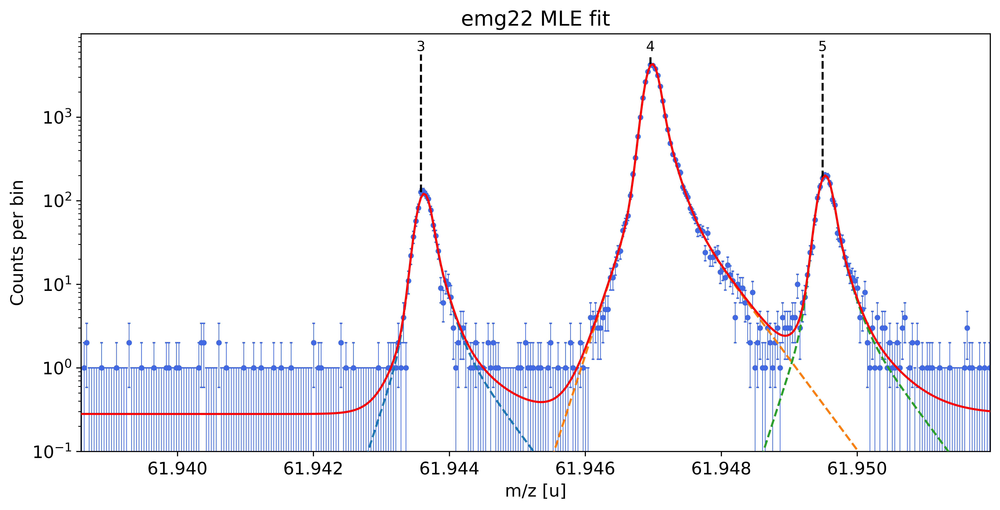

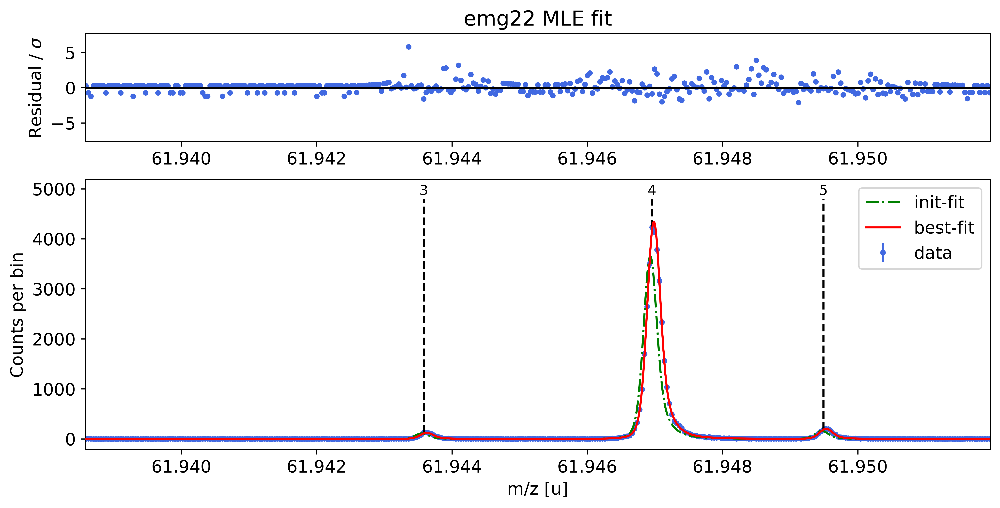

In [9]:
spec.plot_fit_zoom(peak_indeces=[3,4]) # zoom to region around peaks 3 and 4 

## Perform parametric bootstrap to get refined statistical uncertainties (optional)
The `A_stat_emg` determination with [determine_A_stat_emg()](modules.rst#emgfit.spectrum.spectrum.determine_A_stat_emg) relies on fits of bootstrapped subspectra of a single reference peak. The obtained A_stat_emg factor is then used to estimate the statistical uncertainties of all peaks. 

As an alternative, the statistical uncertainty can be estimated for each peak individually using the [get_errors_from_resampling()](modules.rst#emgfit.spectrum.spectrum.get_errors_from_resampling) method. In this method synthetic spectra are created for all peaks of interest by resampling events from the best-fit curve ("parametric bootstrap"). As opposed to the non-parametric bootstrap of [determine_A_stat_emg()](modules.rst#emgfit.spectrum.spectrum.determine_A_stat_emg), this technique is also applicable to low statistics peaks (assuming that the fit model describes the data well). The fits of the peaks of interest are re-performed using a large number of synthetic spectra (by default: `N_spectra`=1000) and the statistical mass and area uncertainties are estimated using the standard deviations of the obtained fit results. Finally, the original statistical mass and area uncertainties in the peak properties table are overwritten with the new values. 

In [10]:
# NOTE: For quicker run time in this demo, the number of synthetic spectra to fit `N_spectra` was manually reduced. 
# For reliable results run this method with at least the default value of N_spectra=1000

spec.get_errors_from_resampling(N_spectra=20) # arguments adapted for demonstration 
#spec.get_errors_from_resampling() # typical execution with default arguments

Fitting 20 simulated spectra to determine statistical mass and peak area errors.


Updated the statistical and peak area uncertainties of peak(s) 0, 1, 2, 3, 4, 5, 6, 7.

Re-calculated mass recalibration error from updated statistical uncertainty of mass calibrant.
Updated total mass errors of peaks 0, 1, 2, 3, 5, 6, 7.

Updated peak properties table: 


,x_pos,species,comment,m_AME,m_AME_error,extrapolated,fit_model,cost_func,red_chi,area,area_error,m_ion,rel_stat_error,rel_recal_error,rel_peakshape_error,rel_mass_error,A,atomic_ME_keV,mass_error_keV,m_dev_keV
0,61.927764,Ni62:-1e,-,61.927796,0.000000,False,emg22,MLE,1.21,38.28,8.19,blinded,3.45e-07,9.77e-09,2.96e-08,3.46e-07,62,blinded,19.96,blinded
1,61.931984,Cu62:-1e?,-,61.932046,0.000001,False,emg22,MLE,1.21,27.57,5.84,61.932050,4.28e-07,9.77e-09,2.59e-08,4.29e-07,62,-62783.57,24.73,3.86
2,61.934333,?,Non-isobaric,nan,nan,False,emg22,MLE,1.21,3870.07,51.60,61.934369,3.58e-08,9.77e-09,1.62e-08,4.05e-08,nan,nan,2.34,nan
3,61.943581,Ga62:-1e,-,61.943641,0.000001,False,emg22,MLE,1.21,953.41,36.55,blinded,6.76e-08,9.77e-09,8.82e-09,6.89e-08,62,blinded,3.98,blinded
4,61.946958,Ti46:O16:-1e,mass calibrant,61.946993,0.000000,False,emg22,MLE,1.21,33991.42,109.11,61.946993,9.35e-09,9.77e-09,nan,nan,62,-48864.81,nan,0.00
5,61.949490,Sc46:O16:-1e,-,61.949534,0.000001,False,emg22,MLE,1.21,1572.94,40.24,61.949540,4.13e-08,9.77e-09,1.12e-08,4.39e-08,62,-46492.43,2.53,5.80
6,61.956574,Ca43:F19:-1e,shape calibrant,61.956621,0.000000,False,emg22,MLE,1.21,25955.17,116.19,61.956622,1.00e-08,9.77e-09,1.99e-09,1.41e-08,62,-39895.66,0.82,0.61
7,61.958960,?,-,nan,nan,False,emg22,MLE,1.21,28.30,6.68,61.959016,5.26e-07,9.77e-09,1.71e-07,5.53e-07,nan,nan,31.93,nan


         stat. errors from resampling


## Get refined peak-shape uncertainties using MCMC parameter samples (optional)
The default peak-shape error estimation in [fit_peaks()](modules.rst#emgfit.spectrum.spectrum.fit_peaks) relies on some simplifying assumptions:

1. The posterior distributions of the shape parameters follow normal distributions. 
2. The shape parameters are uncorrelated. 

In many cases, at least one of those assumptions is violated. Therefore, a refined way of estimating the peak-shape uncertainties has been added to emgfit: [get_MC_peakshape_errors()](modules.rst#emgfit.spectrum.spectrum.get_MC_peakshape_errors). This method uses Markov-Chain Monte Carlo (MCMC) sampling to estimate the posterior distributions of the shape parameters. The sampling results are compiled in a corner plot/"covariance map" which includes both 1D-histograms of the parameter posteriors and 2D-histograms of the parameter correlations. By randomly drawing shape parameters sets from the obtained MCMC samples one obtains a representation of all peak shapes supported by the data. The calibrant and the peaks of interest are then re-fitted with all drawn shape parameter sets. Refined peak-shape uncertainties are obtained from the RMS deviation of the resulting mass values and peak areas from the best-fit values obtained with [fit_peaks()](modules.rst#emgfit.spectrum.spectrum.fit_peaks). Usually, accounting for parameter correlations results in significantly smaller peak-shape errors.

The MCMC sampling can also already be performed during the peak-shape calibration using the `map_par_covar` option of 
[determine_peak_shape()](modules.rst#emgfit.spectrum.spectrum.determine_peak_shape). The corner plot of the parameter covariances can be used to assess whether [get_MC_peakshape_errors()](modules.rst#emgfit.spectrum.spectrum.get_MC_peakshape_errors) should be run. For more details on the MC peak-shape uncertainty estimation see docs of [get_MC_peakshape_errors()](modules.rst#emgfit.spectrum.spectrum.get_MC_peakshape_errors).


### Evaluating posterior PDFs using MCMC sampling ###

Number of varied parameters:         ndim = 11
Number of MCMC steps:               steps = 1000
Number of initial steps to discard:  burn = 500
Length of thinning interval:         thin = 20


Number of CPU cores to use:       n_cores = 2


The chain is shorter than 50 times the integrated autocorrelation time for 11 parameter(s). Use this estimate with caution and run a longer chain!
N/50 = 20;
tau: [71.04918102 62.40278376 71.54584778 71.25856301 72.64610644 74.48803582
 71.22230774 74.91407126 72.32079011 75.1913835  74.45363309]


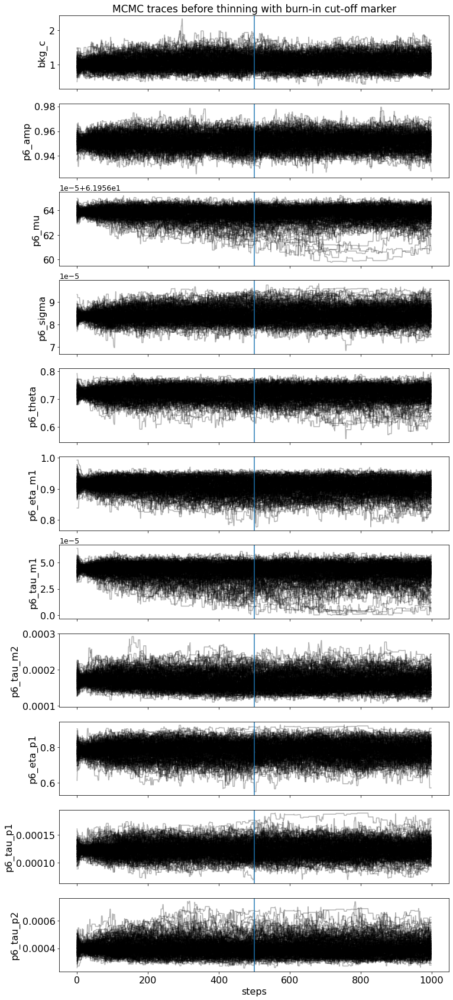

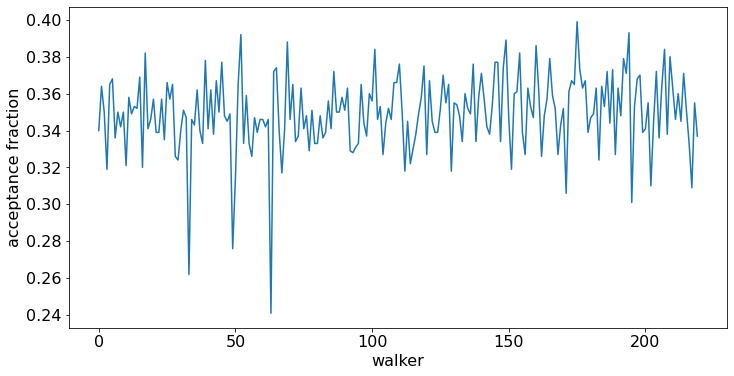

N/50 = 20;
tau: [71.04918102 62.40278376 71.54584778 71.25856301 72.64610644 74.48803582
 71.22230774 74.91407126 72.32079011 75.1913835  74.45363309]


/opt/hostedtoolcache/Python/3.8.6/x64/lib/python3.8/site-packages/emgfit/spectrum.py:1919: UserWarning: Thinning interval `thin` is less than the integrated autocorrelation time for at least one parameter. Consider increasing `thin` MCMC keyword argument to ensure independent parameter samples.
  warnings.warn("Thinning interval `thin` is less than the "


Autocorrelation time for the parameters:
----------------------------------------
     bkg_c: 71.05 steps
    p6_amp: 62.40 steps
     p6_mu: 71.55 steps
  p6_sigma: 71.26 steps
  p6_theta: 72.65 steps
 p6_eta_m1: 74.49 steps
 p6_tau_m1: 71.22 steps
 p6_tau_m2: 74.91 steps
 p6_eta_p1: 72.32 steps
 p6_tau_p1: 75.19 steps
 p6_tau_p2: 74.45 steps

Total number of MCMC parameter sets after discarding burn-in and thinning: 5500 


Covariance map for peak 6 with 0.16, 0.50 & 0.84 quantiles (dashed lines) and best-fit values (blue lines):


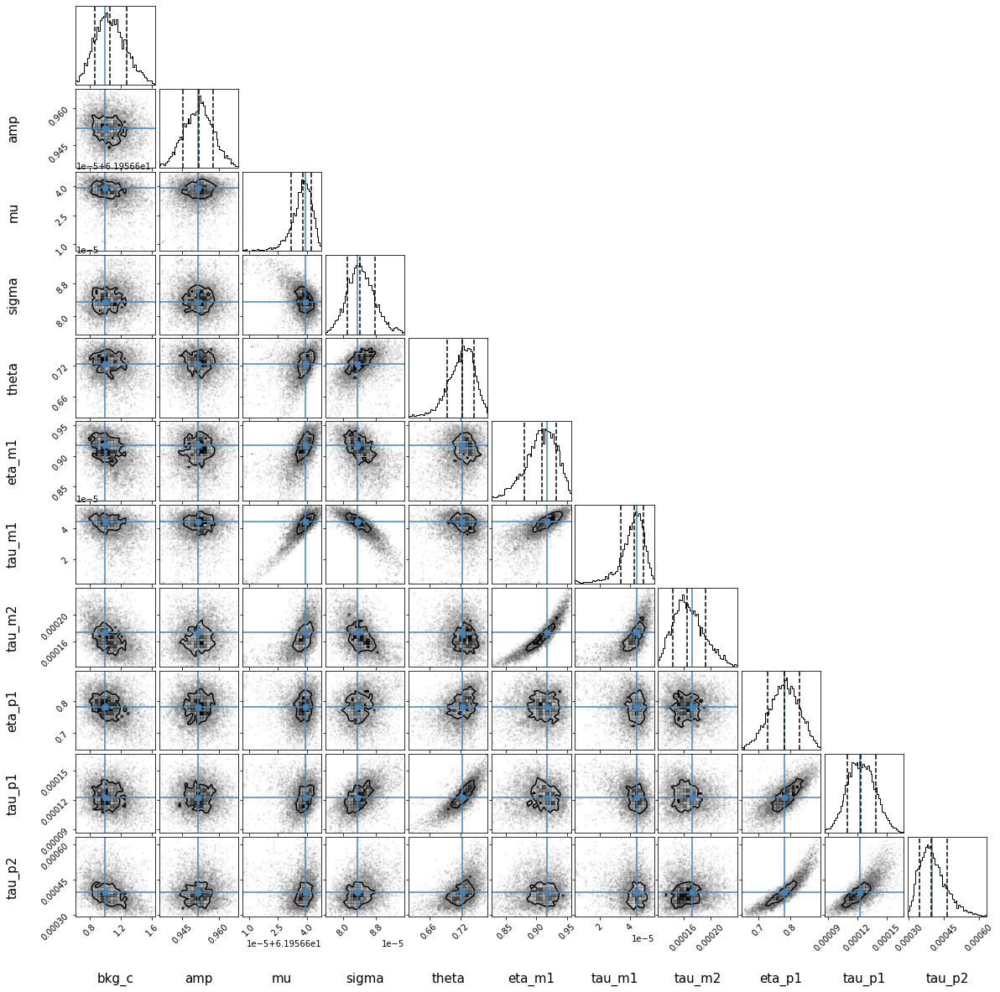


##### MC Peak-shape uncertainty evaluation for peaks 0,1,2,3,4,5,6,7 #####

Determining MC recalibration factors from shifted centroids of mass calibrant.

All mass uncertainties below take into account the corresponding mass shifts of the calibrant peak.

Fitting peaks with 50 different MCMC-shape-parameter sets to determine refined peak-shape errors.


### Results ###

         Relative peak-shape (mass) uncertainty     Peak-shape uncertainty of 
         from +-1σ variation / from MC samples      peak areas from MC samples
Peak  0:           2.96e-08  /  9.21e-09                     0.2 counts
Peak  1:           2.59e-08  /  6.73e-09                     0.3 counts
Peak  2:           1.62e-08  /  3.36e-09                     1.6 counts
Peak  3:           8.82e-09  /  1.62e-09                     0.9 counts
Peak  4:           0.00e+00  /  0.00e+00                     7.9 counts
Peak  5:           1.12e-08  /  3.37e-09                     4.6 counts
Peak  6:           1.99e-09  /  7.17e-10                     6.6 counts
Peak  7:           1.71e-07  /  4.74e-08                     2.2 counts

Updated area error, peak-shape error and (total) mass error of peak(s) 0,1,2,3,4,5,6,7.


Peak properties table after MC peak-shape error evaluation:


,x_pos,species,comment,m_AME,m_AME_error,extrapolated,fit_model,cost_func,red_chi,area,area_error,m_ion,rel_stat_error,rel_recal_error,rel_peakshape_error,rel_mass_error,A,atomic_ME_keV,mass_error_keV,m_dev_keV
0,61.927764,Ni62:-1e,-,61.927796,0.000000,False,emg22,MLE,1.21,38.28,8.15,blinded,3.45e-07,9.77e-09,9.21e-09,3.45e-07,62,blinded,19.90,blinded
1,61.931984,Cu62:-1e?,-,61.932046,0.000001,False,emg22,MLE,1.21,27.57,5.72,61.932050,4.28e-07,9.77e-09,6.73e-09,4.28e-07,62,-62783.57,24.69,3.86
2,61.934333,?,Non-isobaric,nan,nan,False,emg22,MLE,1.21,3870.07,51.40,61.934369,3.58e-08,9.77e-09,3.36e-09,3.73e-08,nan,nan,2.15,nan
3,61.943581,Ga62:-1e,-,61.943641,0.000001,False,emg22,MLE,1.21,953.41,36.33,blinded,6.76e-08,9.77e-09,1.62e-09,6.84e-08,62,blinded,3.94,blinded
4,61.946958,Ti46:O16:-1e,mass calibrant,61.946993,0.000000,False,emg22,MLE,1.21,33991.42,109.39,61.946993,9.35e-09,9.77e-09,nan,nan,62,-48864.81,nan,0.00
5,61.949490,Sc46:O16:-1e,-,61.949534,0.000001,False,emg22,MLE,1.21,1572.94,39.39,61.949540,4.13e-08,9.77e-09,3.37e-09,4.26e-08,62,-46492.43,2.46,5.80
6,61.956574,Ca43:F19:-1e,shape calibrant,61.956621,0.000000,False,emg22,MLE,1.21,25955.17,115.09,61.956622,1.00e-08,9.77e-09,7.17e-10,1.40e-08,62,-39895.66,0.81,0.61
7,61.958960,?,-,nan,nan,False,emg22,MLE,1.21,28.30,5.42,61.959016,5.26e-07,9.77e-09,4.74e-08,5.28e-07,nan,nan,30.49,nan


         stat. errors from resampling     Monte Carlo peakshape errors


In [11]:
# NOTE: For quicker run time in this demo, the length of the sampling chain, the thinning interval and the number 
# of shape parameter sets to perform fits with were manually reduced with the `steps`, `thin` and 
# `N_samples` arguments, respectively. This triggers a warning about the insufficient MCMC chain length. 
# For reasonable results those parameters should be increased to at least their default values. 
# For this specific data decent results are obtained using the following: steps = 16000, thin = 280, N_samples = 1000

spec.get_MC_peakshape_errors(steps=1000, thin=20, N_samples=50) # arguments adapted for demonstration
#spec.get_MC_peakshape_errors() # typical execution with default arguments

## Export fit results
Once all peaks have been fitted, the results can be exported to an XLSX Excel file and a separate file with the peak-shape calibration parameters by using the [save_results()](modules.rst#emgfit.spectrum.spectrum.save_results) method. The XLSX file contains three sheets: 

1. General properties of the spectrum object, e.g. input filename, used versions of emgfit and all relevant dependencies  
2. The peak properties table with all fit results along with linear and logarithmic plots of all peak fits
3. The mass shifts obtained via $\pm1\sigma$ variation of the shape parameters in the default peak-shape uncertainty evaluation 

In [12]:
spec.save_results('outputs/'+filename+' fitting MLE')

Fit results saved to file: outputs/2019-09-13_004-_006 SUMMED High stats 62Ga fitting MLE.xlsx

Peak-shape calibration saved to file: outputs/2019-09-13_004-_006 SUMMED High stats 62Ga fitting MLE_peakshape_calib.txt


**That's it! In principle we're be done with the fitting at this point.**  Next we would probably take a look at the output file and proceed with some post-processing in Excel (e.g. combining mass values from different spectra etc.). 

However, since emgfit gives the user a large amount of freedom, there's are a number of things that could have been done differently depending on your preferences. So here is some possible...  





## Alternative procedures:

The above steps represent a full spectrum analysis. However, emgfit gives the user the freedom to take many different routes in processing the spectrum. Some of the possible alternatives are presented in the following: 

### Alternative 1: Performing the mass recalibration separately before the ion-of-interest fits
All steps up to the final peak fit are identical. For breviety here we simply create an exact clone of the above spectrum object:

In [13]:
import copy
spec2 = copy.deepcopy(spec) # create a clone of the spectrum object

#### First obtain the recalibration factor from a fit of the mass calibrant

##### Calibrant fit #####


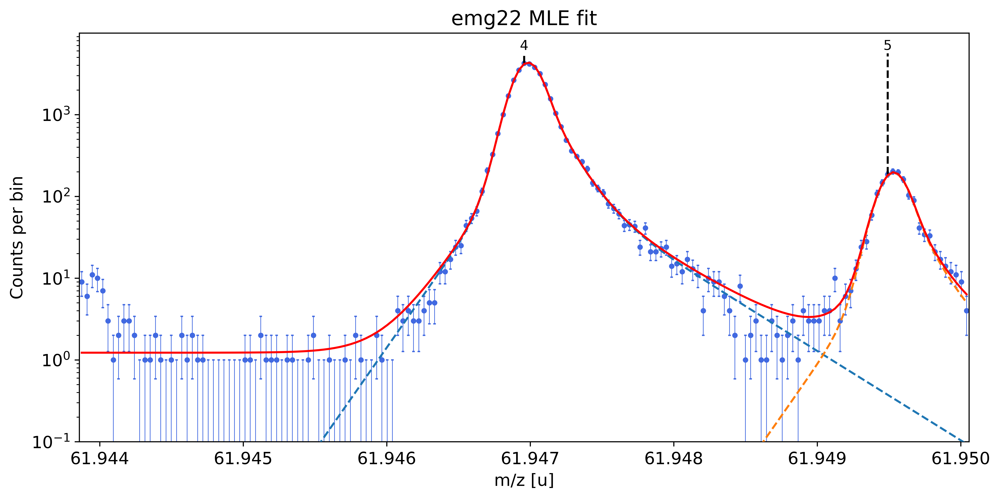

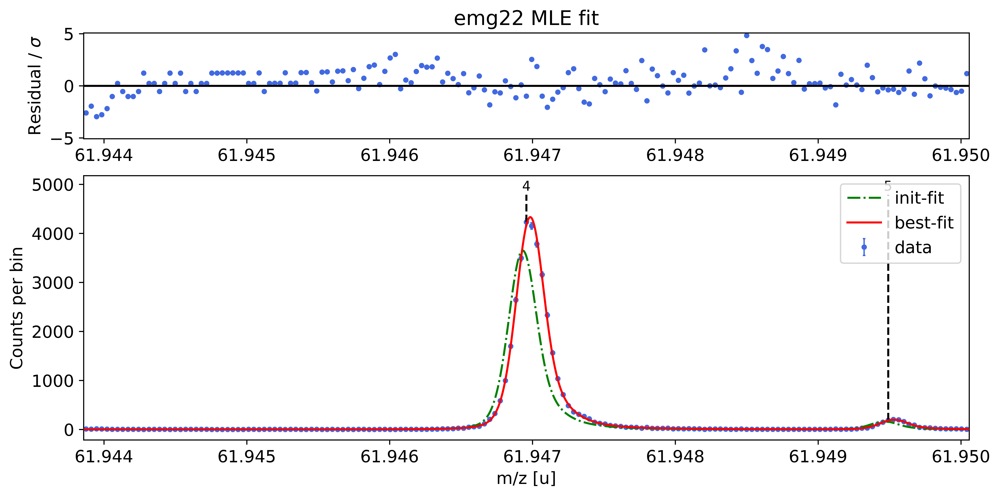


##### Mass recalibration #####

Relative literature error of mass calibrant:     2.8e-09
Relative statistical error of mass calibrant:    1.2e-08

Recalibration factor:    0.999999716 = 1 -2.8e-07
Relative recalibration error:    1.2e-08 



In [14]:
spec2.fit_calibrant(species_mass_calib='Ti46:O16:-1e', show_fit_report=False)

#### Fit all peaks and use the mass recalibration factor from above to calculate the final mass values

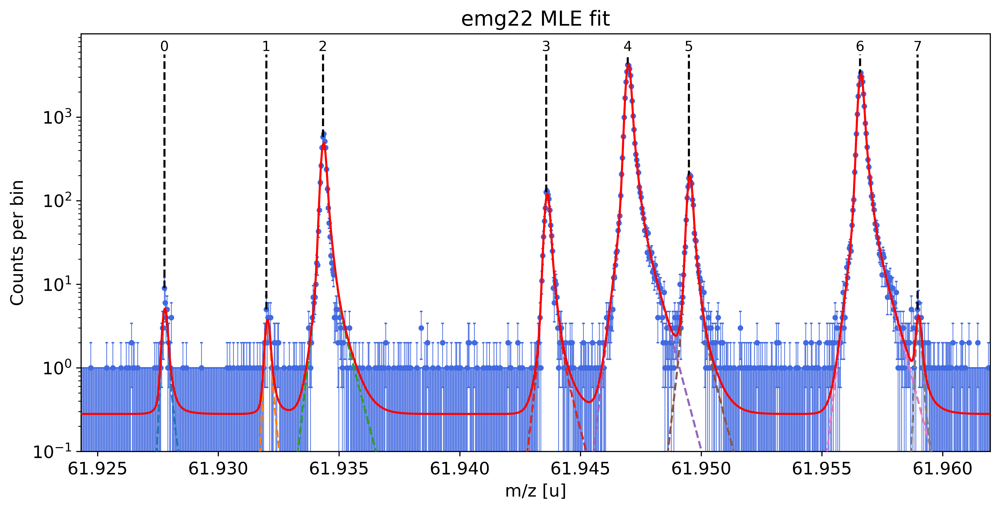

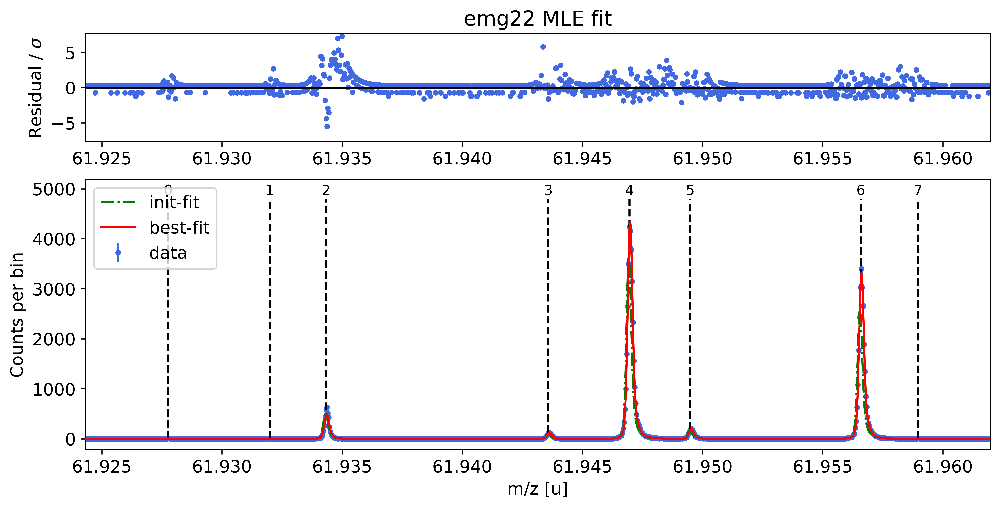


##### Peak-shape uncertainty evaluation #####

Determining centroid shifts of mass calibrant.

All mass shifts below are corrected for the corresponding shifts of the mass calibrant peak.



Re-fitting with sigma  =  8.34e-05 +/- 3.02e-06 shifts peak  0 by  -0.23  /   0.20 μu  & its area by   0.1 /  -0.1 counts.
Re-fitting with sigma  =  8.34e-05 +/- 3.02e-06 shifts peak  1 by   0.45  /  -0.44 μu  & its area by   0.1 /  -0.1 counts.
Re-fitting with sigma  =  8.34e-05 +/- 3.02e-06 shifts peak  2 by  -0.33  /   0.28 μu  & its area by   0.2 /  -0.2 counts.
Re-fitting with sigma  =  8.34e-05 +/- 3.02e-06 shifts peak  3 by  -0.06  /  -0.00 μu  & its area by   0.2 /  -0.2 counts.
Re-fitting with sigma  =  8.34e-05 +/- 3.02e-06 shifts peak  5 by  -0.04  /  -0.02 μu  & its area by   0.5 /  -0.6 counts.
Re-fitting with sigma  =  8.34e-05 +/- 3.02e-06 shifts peak  6 by  -0.01  /  -0.02 μu  & its area by   0.3 /  -0.4 counts.
Re-fitting with sigma  =  8.34e-05 +/- 3.02e-06 shifts peak  7 by  -0.18  /   0.04 μu  & its area by   0.2 /  -0.2 counts.



Re-fitting with theta  =  7.23e-01 +/- 2.43e-02 shifts peak  0 by  -0.98  /   0.49 μu  & its area by  -0.2 /   0.2 counts.
Re-fitting with theta  =  7.23e-01 +/- 2.43e-02 shifts peak  1 by  -1.21  /   1.01 μu  & its area by  -0.4 /   0.3 counts.
Re-fitting with theta  =  7.23e-01 +/- 2.43e-02 shifts peak  2 by  -0.31  /   0.37 μu  & its area by  -0.6 /   0.6 counts.
Re-fitting with theta  =  7.23e-01 +/- 2.43e-02 shifts peak  3 by  -0.27  /   0.11 μu  & its area by  -1.3 /   0.8 counts.
Re-fitting with theta  =  7.23e-01 +/- 2.43e-02 shifts peak  5 by  -0.24  /   0.22 μu  & its area by  -0.3 /   0.1 counts.
Re-fitting with theta  =  7.23e-01 +/- 2.43e-02 shifts peak  6 by  -0.04  /   0.04 μu  & its area by  -2.8 /   2.1 counts.
Re-fitting with theta  =  7.23e-01 +/- 2.43e-02 shifts peak  7 by  -2.83  /   1.82 μu  & its area by   0.1 /  -0.2 counts.



Re-fitting with eta_m1 =  9.17e-01 +/- 2.43e-02 shifts peak  0 by   0.72  /  -1.09 μu  & its area by  -0.4 /   0.3 counts.
Re-fitting with eta_m1 =  9.17e-01 +/- 2.43e-02 shifts peak  1 by   0.31  /  -0.36 μu  & its area by  -0.4 /   0.3 counts.
Re-fitting with eta_m1 =  9.17e-01 +/- 2.43e-02 shifts peak  2 by   0.43  /  -0.32 μu  & its area by  -1.9 /   1.4 counts.
Re-fitting with eta_m1 =  9.17e-01 +/- 2.43e-02 shifts peak  3 by   0.30  /  -0.28 μu  & its area by  -1.1 /   0.8 counts.
Re-fitting with eta_m1 =  9.17e-01 +/- 2.43e-02 shifts peak  5 by   0.25  /  -0.22 μu  & its area by  -4.0 /   3.0 counts.
Re-fitting with eta_m1 =  9.17e-01 +/- 2.43e-02 shifts peak  6 by   0.01  /  -0.08 μu  & its area by  -4.5 /   1.9 counts.
Re-fitting with eta_m1 =  9.17e-01 +/- 2.43e-02 shifts peak  7 by   0.52  /  -1.01 μu  & its area by  -0.5 /   0.4 counts.



Re-fitting with tau_m1 =  4.45e-05 +/- 6.08e-06 shifts peak  0 by  -0.89  /   0.80 μu  & its area by   0.2 /  -0.2 counts.
Re-fitting with tau_m1 =  4.45e-05 +/- 6.08e-06 shifts peak  1 by   0.25  /  -0.29 μu  & its area by   0.2 /  -0.2 counts.
Re-fitting with tau_m1 =  4.45e-05 +/- 6.08e-06 shifts peak  2 by  -0.47  /   0.44 μu  & its area by   0.4 /  -0.3 counts.
Re-fitting with tau_m1 =  4.45e-05 +/- 6.08e-06 shifts peak  3 by  -0.13  /   0.07 μu  & its area by   0.4 /  -0.4 counts.
Re-fitting with tau_m1 =  4.45e-05 +/- 6.08e-06 shifts peak  5 by  -0.14  /   0.08 μu  & its area by   1.0 /  -0.8 counts.
Re-fitting with tau_m1 =  4.45e-05 +/- 6.08e-06 shifts peak  6 by   0.00  /  -0.00 μu  & its area by   0.5 /  -0.5 counts.
Re-fitting with tau_m1 =  4.45e-05 +/- 6.08e-06 shifts peak  7 by  -0.99  /   0.92 μu  & its area by   0.3 /  -0.2 counts.



Re-fitting with tau_m2 =  1.73e-04 +/- 2.43e-05 shifts peak  0 by  -0.06  /   0.54 μu  & its area by   0.3 /  -0.4 counts.
Re-fitting with tau_m2 =  1.73e-04 +/- 2.43e-05 shifts peak  1 by  -0.11  /   0.12 μu  & its area by   0.4 /  -0.5 counts.
Re-fitting with tau_m2 =  1.73e-04 +/- 2.43e-05 shifts peak  2 by  -0.25  /   0.16 μu  & its area by   1.9 /  -2.6 counts.
Re-fitting with tau_m2 =  1.73e-04 +/- 2.43e-05 shifts peak  3 by  -0.14  /   0.21 μu  & its area by   0.8 /  -1.2 counts.
Re-fitting with tau_m2 =  1.73e-04 +/- 2.43e-05 shifts peak  5 by  -0.07  /   0.11 μu  & its area by   3.3 /  -4.0 counts.
Re-fitting with tau_m2 =  1.73e-04 +/- 2.43e-05 shifts peak  6 by   0.02  /   0.01 μu  & its area by   5.7 /  -8.0 counts.
Re-fitting with tau_m2 =  1.73e-04 +/- 2.43e-05 shifts peak  7 by   0.10  /  -0.13 μu  & its area by   0.4 /  -0.6 counts.



Re-fitting with eta_p1 =  7.84e-01 +/- 4.71e-02 shifts peak  0 by  -0.06  /   0.07 μu  & its area by  -0.3 /   0.3 counts.
Re-fitting with eta_p1 =  7.84e-01 +/- 4.71e-02 shifts peak  1 by  -0.30  /   0.16 μu  & its area by  -0.5 /   0.4 counts.
Re-fitting with eta_p1 =  7.84e-01 +/- 4.71e-02 shifts peak  2 by  -0.24  /   0.22 μu  & its area by  -1.9 /   1.4 counts.
Re-fitting with eta_p1 =  7.84e-01 +/- 4.71e-02 shifts peak  3 by  -0.14  /   0.11 μu  & its area by  -2.1 /   1.7 counts.
Re-fitting with eta_p1 =  7.84e-01 +/- 4.71e-02 shifts peak  5 by  -0.27  /   0.17 μu  & its area by   0.1 /  -0.6 counts.
Re-fitting with eta_p1 =  7.84e-01 +/- 4.71e-02 shifts peak  6 by  -0.01  /  -0.03 μu  & its area by  -6.7 /   5.1 counts.
Re-fitting with eta_p1 =  7.84e-01 +/- 4.71e-02 shifts peak  7 by  -3.99  /   3.15 μu  & its area by   0.9 /  -0.9 counts.



Re-fitting with tau_p1 =  1.23e-04 +/- 1.37e-05 shifts peak  0 by   0.11  /   0.03 μu  & its area by   0.1 /  -0.1 counts.
Re-fitting with tau_p1 =  1.23e-04 +/- 1.37e-05 shifts peak  1 by   0.38  /  -0.59 μu  & its area by   0.3 /  -0.4 counts.
Re-fitting with tau_p1 =  1.23e-04 +/- 1.37e-05 shifts peak  2 by   0.41  /  -0.46 μu  & its area by   0.4 /  -0.5 counts.
Re-fitting with tau_p1 =  1.23e-04 +/- 1.37e-05 shifts peak  3 by   0.18  /  -0.18 μu  & its area by   0.6 /  -0.6 counts.
Re-fitting with tau_p1 =  1.23e-04 +/- 1.37e-05 shifts peak  5 by   0.04  /  -0.05 μu  & its area by   1.1 /  -1.1 counts.
Re-fitting with tau_p1 =  1.23e-04 +/- 1.37e-05 shifts peak  6 by   0.02  /   0.00 μu  & its area by   1.0 /   1.5 counts.
Re-fitting with tau_p1 =  1.23e-04 +/- 1.37e-05 shifts peak  7 by   0.39  /  -0.53 μu  & its area by   0.3 /  -0.4 counts.



Re-fitting with tau_p2 =  3.98e-04 +/- 5.34e-05 shifts peak  0 by   0.11  /  -0.01 μu  & its area by   0.4 /  -0.5 counts.
Re-fitting with tau_p2 =  3.98e-04 +/- 5.34e-05 shifts peak  1 by   0.32  /  -0.39 μu  & its area by   0.5 /  -0.6 counts.
Re-fitting with tau_p2 =  3.98e-04 +/- 5.34e-05 shifts peak  2 by  -0.02  /  -0.08 μu  & its area by   2.7 /  -2.9 counts.
Re-fitting with tau_p2 =  3.98e-04 +/- 5.34e-05 shifts peak  3 by   0.04  /  -0.07 μu  & its area by   2.4 /  -2.7 counts.
Re-fitting with tau_p2 =  3.98e-04 +/- 5.34e-05 shifts peak  5 by   0.43  /  -0.48 μu  & its area by  -7.4 /   4.7 counts.
Re-fitting with tau_p2 =  3.98e-04 +/- 5.34e-05 shifts peak  6 by  -0.00  /   0.04 μu  & its area by  11.6 / -12.6 counts.
Re-fitting with tau_p2 =  3.98e-04 +/- 5.34e-05 shifts peak  7 by   5.06  /  -9.24 μu  & its area by  -4.3 /   3.3 counts.

Relative peak-shape error of peak  0:  2.9e-08
Relative peak-shape error of peak  1:  2.5e-08
Relative peak-shape error of peak  2:  1.6e-

,x_pos,species,comment,m_AME,m_AME_error,extrapolated,fit_model,cost_func,red_chi,area,area_error,m_ion,rel_stat_error,rel_recal_error,rel_peakshape_error,rel_mass_error,A,atomic_ME_keV,mass_error_keV,m_dev_keV
0,61.927764,Ni62:-1e,-,61.927796,0.000000,False,emg22,MLE,1.21,38.28,6.82,blinded,3.45e-07,1.19e-08,2.94e-08,3.47e-07,62,blinded,20.00,blinded
1,61.931984,Cu62:-1e?,-,61.932046,0.000001,False,emg22,MLE,1.21,27.57,6.08,61.932050,4.07e-07,1.19e-08,2.55e-08,4.08e-07,62,-62783.58,23.52,3.85
2,61.934333,?,Non-isobaric,nan,nan,False,emg22,MLE,1.21,3870.07,62.72,61.934369,3.43e-08,1.19e-08,1.60e-08,3.97e-08,nan,nan,2.29,nan
3,61.943581,Ga62:-1e,-,61.943641,0.000001,False,emg22,MLE,1.21,953.41,31.44,blinded,6.92e-08,1.19e-08,8.69e-09,7.07e-08,62,blinded,4.08,blinded
4,61.946958,Ti46:O16:-1e,mass calibrant,61.946993,0.000000,False,emg22,MLE,1.85,33924.39,185.95,61.946993,1.16e-08,1.19e-08,nan,nan,62,-48864.81,nan,0.00
5,61.949490,Sc46:O16:-1e,-,61.949534,0.000001,False,emg22,MLE,1.21,1572.94,41.19,61.949540,5.38e-08,1.19e-08,1.10e-08,5.62e-08,62,-46492.44,3.25,5.79
6,61.956574,Ca43:F19:-1e,shape calibrant,61.956621,0.000000,False,emg22,MLE,1.21,25955.17,162.18,61.956622,1.33e-08,1.19e-08,1.78e-09,1.79e-08,62,-39895.67,1.03,0.60
7,61.958960,?,-,nan,nan,False,emg22,MLE,1.21,28.30,7.86,61.959016,4.01e-07,1.19e-08,1.71e-07,4.36e-07,nan,nan,25.18,nan


In [15]:
spec2.fit_peaks(show_fit_report=False)

### Alternative 2: Chi-square instead of MLE fitting 
All steps up to the final peak fit are identical. For breviety here we simply create an exact clone of the above spectrum object and re-use the above peak-shape calibration (obtained with chi-square fitting):

Creating synthetic spectra via bootstrap re-sampling and fitting them for A_stat determination.
Depending on the choice of `N_spectra` this can take a few minutes. Interrupt kernel if this takes too long.



Done!

[[Model]]
    Model(powerlaw)
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 5
    # data points      = 8
    # variables        = 1
    chi-square         = 9.8046e-09
    reduced chi-square = 1.4007e-09
    Akaike info crit   = -162.158880
    Bayesian info crit = -162.079438
[[Variables]]
    amplitude:  1.4336e-04 +/- 1.3841e-05 (9.65%) (init = 1)
    exponent:  -0.5 (fixed)


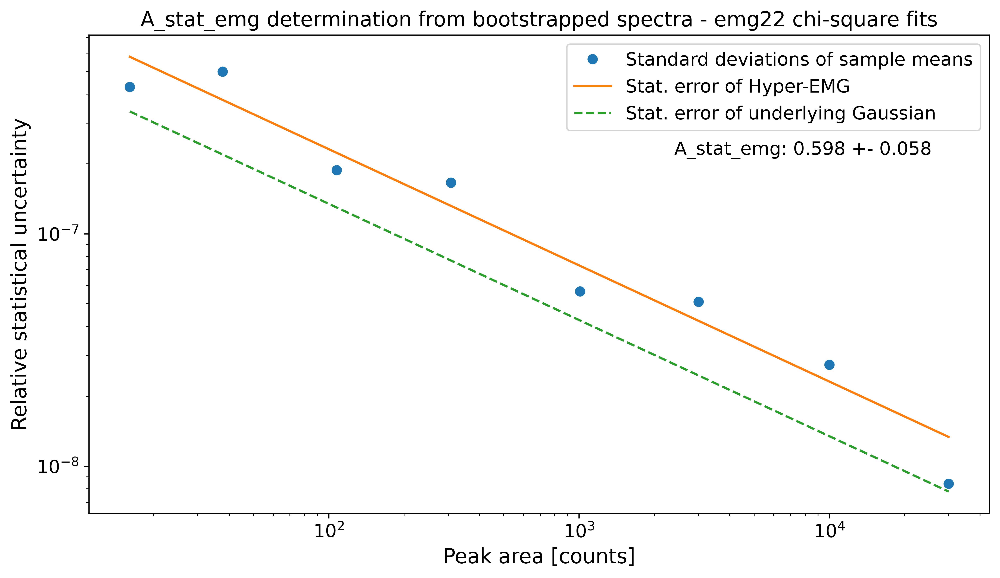

A_stat of a Gaussian model: 0.425
Default A_stat_emg for Hyper-EMG models: 0.52
A_stat_emg for this spectrum's emg22 fit model: 0.598 +- 0.058


In [16]:
import copy
spec_chi_sq = copy.deepcopy(spec) # create a clone of the spectrum object

# Use Pearson's chi-squared statistic for A_stat_emg determination
spec_chi_sq.determine_A_stat_emg(species='Ca43:F19:-1e', x_range=0.004, cost_func='chi-square', 
                                 plot_filename='outputs/'+filename+'_chi-square', N_spectra=10) 

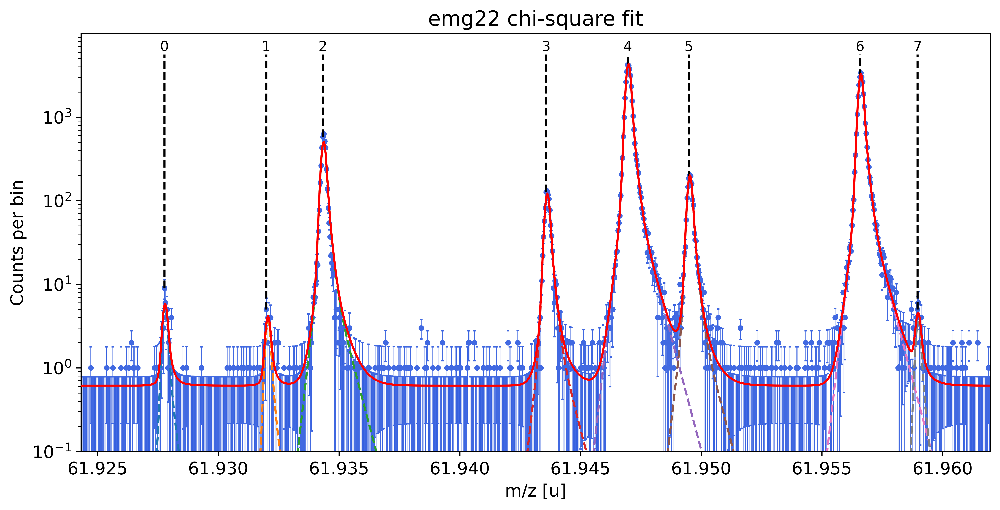

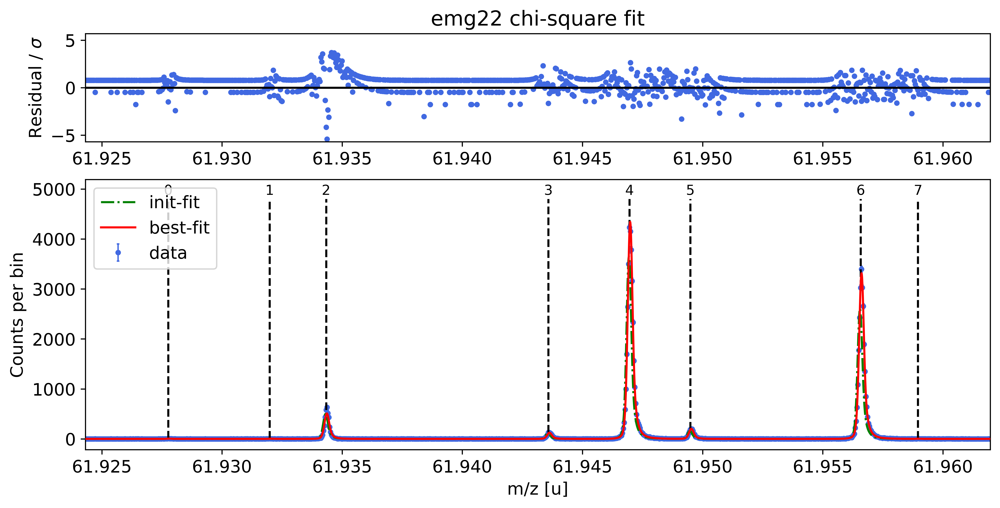


##### Mass recalibration #####

Relative literature error of mass calibrant:     2.8e-09
Relative statistical error of mass calibrant:    1.3e-08

Recalibration factor:    0.999999716 = 1 -2.8e-07
Relative recalibration error:    1.3e-08 


##### Peak-shape uncertainty evaluation #####

Determining centroid shifts of mass calibrant.

All mass shifts below are corrected for the corresponding shifts of the mass calibrant peak.



Re-fitting with sigma  =  8.34e-05 +/- 3.02e-06 shifts peak  0 by   0.52  /  -0.48 μu  & its area by   0.3 /  -0.3 counts.
Re-fitting with sigma  =  8.34e-05 +/- 3.02e-06 shifts peak  1 by   0.69  /  -0.56 μu  & its area by   0.2 /  -0.2 counts.
Re-fitting with sigma  =  8.34e-05 +/- 3.02e-06 shifts peak  2 by  -0.33  /   0.34 μu  & its area by  18.6 / -17.0 counts.
Re-fitting with sigma  =  8.34e-05 +/- 3.02e-06 shifts peak  3 by  -0.11  /   0.11 μu  & its area by   1.9 /  -1.4 counts.
Re-fitting with sigma  =  8.34e-05 +/- 3.02e-06 shifts peak  5 by  -0.05  /   0.05 μu  & its area by   2.1 /  -1.4 counts.
Re-fitting with sigma  =  8.34e-05 +/- 3.02e-06 shifts peak  6 by   0.01  /  -0.01 μu  & its area by   7.6 /   7.1 counts.
Re-fitting with sigma  =  8.34e-05 +/- 3.02e-06 shifts peak  7 by  -2.13  /   1.96 μu  & its area by   0.3 /  -0.3 counts.



Re-fitting with theta  =  7.23e-01 +/- 2.43e-02 shifts peak  0 by  -0.69  /   0.59 μu  & its area by  -0.4 /   0.4 counts.
Re-fitting with theta  =  7.23e-01 +/- 2.43e-02 shifts peak  1 by  -1.33  /   1.16 μu  & its area by  -0.5 /   0.4 counts.
Re-fitting with theta  =  7.23e-01 +/- 2.43e-02 shifts peak  2 by  -0.65  /   0.59 μu  & its area by -18.0 /  18.5 counts.
Re-fitting with theta  =  7.23e-01 +/- 2.43e-02 shifts peak  3 by  -0.27  /   0.24 μu  & its area by  -2.4 /   2.6 counts.
Re-fitting with theta  =  7.23e-01 +/- 2.43e-02 shifts peak  5 by  -0.16  /   0.16 μu  & its area by   0.1 /   0.5 counts.
Re-fitting with theta  =  7.23e-01 +/- 2.43e-02 shifts peak  6 by  -0.02  /   0.02 μu  & its area by   5.2 /   9.6 counts.
Re-fitting with theta  =  7.23e-01 +/- 2.43e-02 shifts peak  7 by  -2.40  /   2.20 μu  & its area by   0.1 /  -0.2 counts.



Re-fitting with eta_m1 =  9.17e-01 +/- 2.43e-02 shifts peak  0 by   0.51  /  -0.44 μu  & its area by  -0.6 /   0.4 counts.
Re-fitting with eta_m1 =  9.17e-01 +/- 2.43e-02 shifts peak  1 by   0.07  /  -0.08 μu  & its area by  -0.6 /   0.4 counts.
Re-fitting with eta_m1 =  9.17e-01 +/- 2.43e-02 shifts peak  2 by   0.53  /  -0.44 μu  & its area by  -8.7 /   9.7 counts.
Re-fitting with eta_m1 =  9.17e-01 +/- 2.43e-02 shifts peak  3 by   0.49  /  -0.35 μu  & its area by  -2.7 /   2.4 counts.
Re-fitting with eta_m1 =  9.17e-01 +/- 2.43e-02 shifts peak  5 by   0.24  /  -0.14 μu  & its area by  -4.2 /   3.3 counts.
Re-fitting with eta_m1 =  9.17e-01 +/- 2.43e-02 shifts peak  6 by   0.03  /  -0.02 μu  & its area by   6.3 /  11.6 counts.
Re-fitting with eta_m1 =  9.17e-01 +/- 2.43e-02 shifts peak  7 by   0.95  /  -0.73 μu  & its area by  -0.7 /   0.5 counts.



Re-fitting with tau_m1 =  4.45e-05 +/- 6.08e-06 shifts peak  0 by  -0.63  /   0.62 μu  & its area by   0.4 /  -0.4 counts.
Re-fitting with tau_m1 =  4.45e-05 +/- 6.08e-06 shifts peak  1 by   0.27  /  -0.21 μu  & its area by   0.3 /  -0.3 counts.
Re-fitting with tau_m1 =  4.45e-05 +/- 6.08e-06 shifts peak  2 by  -0.63  /   0.61 μu  & its area by  19.2 / -17.0 counts.
Re-fitting with tau_m1 =  4.45e-05 +/- 6.08e-06 shifts peak  3 by  -0.28  /   0.26 μu  & its area by   2.6 /  -1.9 counts.
Re-fitting with tau_m1 =  4.45e-05 +/- 6.08e-06 shifts peak  5 by  -0.25  /   0.24 μu  & its area by   2.3 /  -1.3 counts.
Re-fitting with tau_m1 =  4.45e-05 +/- 6.08e-06 shifts peak  6 by  -0.04  /   0.03 μu  & its area by  10.3 /   9.0 counts.
Re-fitting with tau_m1 =  4.45e-05 +/- 6.08e-06 shifts peak  7 by  -2.47  /   2.58 μu  & its area by   0.4 /  -0.4 counts.



Re-fitting with tau_m2 =  1.73e-04 +/- 2.43e-05 shifts peak  0 by   0.07  /  -0.08 μu  & its area by   0.5 /  -0.7 counts.
Re-fitting with tau_m2 =  1.73e-04 +/- 2.43e-05 shifts peak  1 by   0.20  /  -0.40 μu  & its area by   0.5 /  -0.8 counts.
Re-fitting with tau_m2 =  1.73e-04 +/- 2.43e-05 shifts peak  2 by  -0.12  /   0.22 μu  & its area by   5.1 /  -5.5 counts.
Re-fitting with tau_m2 =  1.73e-04 +/- 2.43e-05 shifts peak  3 by  -0.17  /   0.29 μu  & its area by   1.8 /  -2.4 counts.
Re-fitting with tau_m2 =  1.73e-04 +/- 2.43e-05 shifts peak  5 by  -0.01  /   0.08 μu  & its area by   3.5 /  -4.5 counts.
Re-fitting with tau_m2 =  1.73e-04 +/- 2.43e-05 shifts peak  6 by   0.01  /  -0.01 μu  & its area by  11.8 /  -2.0 counts.
Re-fitting with tau_m2 =  1.73e-04 +/- 2.43e-05 shifts peak  7 by   0.01  /   0.18 μu  & its area by   0.5 /  -0.8 counts.



Re-fitting with eta_p1 =  7.84e-01 +/- 4.71e-02 shifts peak  0 by  -0.38  /   0.17 μu  & its area by  -0.6 /   0.5 counts.
Re-fitting with eta_p1 =  7.84e-01 +/- 4.71e-02 shifts peak  1 by  -0.72  /   0.40 μu  & its area by  -0.8 /   0.6 counts.
Re-fitting with eta_p1 =  7.84e-01 +/- 4.71e-02 shifts peak  2 by  -0.33  /   0.27 μu  & its area by -10.1 /  10.0 counts.
Re-fitting with eta_p1 =  7.84e-01 +/- 4.71e-02 shifts peak  3 by  -0.22  /   0.16 μu  & its area by  -3.2 /   2.8 counts.
Re-fitting with eta_p1 =  7.84e-01 +/- 4.71e-02 shifts peak  5 by  -0.22  /   0.17 μu  & its area by   0.3 /  -0.6 counts.
Re-fitting with eta_p1 =  7.84e-01 +/- 4.71e-02 shifts peak  6 by   0.02  /  -0.01 μu  & its area by   0.9 /  13.0 counts.
Re-fitting with eta_p1 =  7.84e-01 +/- 4.71e-02 shifts peak  7 by  -8.17  /   5.53 μu  & its area by   1.1 /  -1.0 counts.



Re-fitting with tau_p1 =  1.23e-04 +/- 1.37e-05 shifts peak  0 by  -0.29  /   0.26 μu  & its area by   0.3 /  -0.3 counts.
Re-fitting with tau_p1 =  1.23e-04 +/- 1.37e-05 shifts peak  1 by   0.36  /  -0.69 μu  & its area by   0.4 /  -0.4 counts.
Re-fitting with tau_p1 =  1.23e-04 +/- 1.37e-05 shifts peak  2 by   0.56  /  -0.71 μu  & its area by  14.2 / -14.7 counts.
Re-fitting with tau_p1 =  1.23e-04 +/- 1.37e-05 shifts peak  3 by   0.24  /  -0.30 μu  & its area by   2.3 /  -2.0 counts.
Re-fitting with tau_p1 =  1.23e-04 +/- 1.37e-05 shifts peak  5 by  -0.04  /   0.04 μu  & its area by   0.9 /   0.1 counts.
Re-fitting with tau_p1 =  1.23e-04 +/- 1.37e-05 shifts peak  6 by  -0.00  /  -0.00 μu  & its area by   9.9 /   9.7 counts.
Re-fitting with tau_p1 =  1.23e-04 +/- 1.37e-05 shifts peak  7 by   0.25  /  -0.34 μu  & its area by   0.4 /  -0.4 counts.



Re-fitting with tau_p2 =  3.98e-04 +/- 5.34e-05 shifts peak  0 by   0.43  /  -0.63 μu  & its area by   0.6 /  -0.8 counts.
Re-fitting with tau_p2 =  3.98e-04 +/- 5.34e-05 shifts peak  1 by   0.67  /  -0.96 μu  & its area by   0.7 /  -0.9 counts.
Re-fitting with tau_p2 =  3.98e-04 +/- 5.34e-05 shifts peak  2 by   0.02  /  -0.09 μu  & its area by   5.5 /  -6.4 counts.
Re-fitting with tau_p2 =  3.98e-04 +/- 5.34e-05 shifts peak  3 by   0.05  /  -0.12 μu  & its area by   2.7 /  -3.3 counts.
Re-fitting with tau_p2 =  3.98e-04 +/- 5.34e-05 shifts peak  5 by   0.48  /  -0.57 μu  & its area by  -7.4 /   4.9 counts.
Re-fitting with tau_p2 =  3.98e-04 +/- 5.34e-05 shifts peak  6 by  -0.02  /   0.02 μu  & its area by  17.2 /  -8.5 counts.
Re-fitting with tau_p2 =  3.98e-04 +/- 5.34e-05 shifts peak  7 by   9.50  / -23.96 μu  & its area by  -4.2 /   4.2 counts.

Relative peak-shape error of peak  0:  2.3e-08
Relative peak-shape error of peak  1:  3.4e-08
Relative peak-shape error of peak  2:  2.2e-

,x_pos,species,comment,m_AME,m_AME_error,extrapolated,fit_model,cost_func,red_chi,area,area_error,m_ion,rel_stat_error,rel_recal_error,rel_peakshape_error,rel_mass_error,A,atomic_ME_keV,mass_error_keV,m_dev_keV
0,61.927764,Ni62:-1e,-,61.927796,0.000000,False,emg22,chi-square,0.99,40.82,7.65,blinded,3.62e-07,1.29e-08,2.30e-08,3.63e-07,62,blinded,20.96,blinded
1,61.931984,Cu62:-1e?,-,61.932046,0.000001,False,emg22,chi-square,0.99,28.11,6.88,61.932066,4.37e-07,1.29e-08,3.38e-08,4.38e-07,62,-62768.70,25.27,18.74
2,61.934333,?,Non-isobaric,nan,nan,False,emg22,chi-square,0.99,3989.94,74.98,61.934370,3.66e-08,1.29e-08,2.21e-08,4.47e-08,nan,nan,2.58,nan
3,61.943581,Ga62:-1e,-,61.943641,0.000001,False,emg22,chi-square,0.99,957.52,32.34,blinded,7.48e-08,1.29e-08,1.29e-08,7.70e-08,62,blinded,4.44,blinded
4,61.946958,Ti46:O16:-1e,mass calibrant,61.946993,0.000000,False,emg22,chi-square,0.99,34011.08,184.69,61.946993,1.25e-08,1.29e-08,nan,nan,62,-48864.81,nan,0.00
5,61.949490,Sc46:O16:-1e,-,61.949534,0.000001,False,emg22,chi-square,0.99,1574.60,41.69,61.949540,5.83e-08,1.29e-08,1.18e-08,6.09e-08,62,-46492.47,3.51,5.75
6,61.956574,Ca43:F19:-1e,shape calibrant,61.956621,0.000000,False,emg22,chi-square,0.99,25963.26,164.78,61.956622,1.44e-08,1.29e-08,1.01e-09,1.93e-08,62,-39895.70,1.11,0.57
7,61.958960,?,-,nan,nan,False,emg22,chi-square,0.99,27.98,8.37,61.958997,4.37e-07,1.29e-08,4.14e-07,6.03e-07,nan,nan,34.78,nan


In [17]:
# Fit with Pearson's chi-squared statistic as cost function
spec_chi_sq.fit_peaks(species_mass_calib='Ti46:O16:-1e', cost_func='chi-square', 
                      show_fit_report=False) 